In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("cdc/national-health-and-nutrition-examination-survey")

print("Path to dataset files:", path)

100%|█████████████████████████████████████████████████████████████████████████████| 6.87M/6.87M [00:01<00:00, 6.36MB/s]

Extracting files...


Path to dataset files: C:\Users\raina\.cache\kagglehub\datasets\cdc\national-health-and-nutrition-examination-survey\versions\1


## Data Loading

In [3]:
import pandas as pd
import os

# Define the base path to the dataset
base_path = r'C:\Users\raina\.cache\kagglehub\datasets\cdc\national-health-and-nutrition-examination-survey\versions\1'

# Load demographic data
demographics = pd.read_csv(os.path.join(base_path, 'demographic.csv'))  # Load demographic information

# Load diet data
diet = pd.read_csv(os.path.join(base_path, 'diet.csv'))  # Load diet and nutrition information

# Load examination data
examination = pd.read_csv(os.path.join(base_path, 'examination.csv'))  # Load examination data (e.g., blood pressure, body measures)

# Load laboratory data
labs = pd.read_csv(os.path.join(base_path, 'labs.csv'))  # Load laboratory test results (e.g., blood tests, cholesterol levels)

# Load medications data
medications = pd.read_csv(os.path.join(base_path, 'medications.csv'), encoding='latin1')  # Load prescription medications information

# Load questionnaire data
questionnaire = pd.read_csv(os.path.join(base_path, 'questionnaire.csv'))  # Load questionnaire responses (e.g., health conditions, lifestyle)

## PART 1: Business Understanding and Problem Statement

#### 1. Problem Definition and Key Objectives 

Health problems, such as weight management, high blood pressure, and excessive cholesterol intake, are major challenges affecting the health of populations worldwide today. Through the analysis of BMI classification and related health indicators, we can reveal potential risk factors for obesity and other weight-related health problems.

Problem Definition:
- This study aims to predict an individual's BMI classification based on health datasets such as BMI, blood pressure, cholesterol intake, etc., through data mining techniques.
- Specific objectives are:
  - Identify the relationship between diet, physical activity, and BMI classification.
  - Build predictive models to support health surveillance and interventions.
  - Explore ways to optimize health management to help individuals and medical institutions make better decisions.

**Potential Benefits**:
- By predicting an individual's BMI classification, healthcare facilities can develop targeted interventions to reduce the risk of obesity-related diseases.
- Data mining techniques can reveal complex variable relationships to inform public health policies.
- Personalize health advice to improve the quality of life for residents.

---

#### 2. Background Research and Motivation 

In recent years, numerous studies have shown that dietary habits (such as sodium and cholesterol intake) and lifestyle (such as physical activity) are closely related to BMI classification. For example:
- **Diet**: Studies have shown that excessive intake of cholesterol and high-sodium diets can lead to obesity and high blood pressure [Reference Study 1].
- **Physical activity**: Insufficient physical activity is significantly associated with overweight and obesity [Reference Study 2].
- Disease association: There is an important link between high BMI and a variety of chronic diseases, such as diabetes and cardiovascular disease [Reference Study 3].

**Research Motivation**:
- With obesity rates on the rise globally, there is a growing need for analysis and prediction of health data.
- The use of data mining techniques to analyze large-scale health data can help healthcare organizations identify high-risk individuals more efficiently.
- Provide personalized health advice to reduce the waste of medical resources caused by weight problems.

---

#### 3. Data Mining Tasks and Initial Pipeline 

**Task Type**:
To achieve the research objectives, the following data mining tasks were applied in this study:
1. Data Cleansing: Remove outliers, process missing data, and normalize and code variables.
2. Cluster Analysis: Analyze the relationship between population characteristics, such as diet and BMI classification.
3. Association Rule Mining: Uncover hidden relationships between health variables such as sodium intake, high blood pressure, and BMI classification.
4. **Categorical Prediction**:
   - Build classification models (logistic regression, SVM, random forests, and neural networks) to predict BMI classification.
   - Improve classification performance and evaluate the strengths and weaknesses of different models.

**Preliminary Process & Architecture**:
1. **Data Preparation**:
   - Data cleansing and removal of outliers.
   - Discretize BMI into categorical labels and normalize features.
2. Exploratory Analysis:
   - Understand data relationships through visualization techniques such as correlation heat maps and scatter plots.
3. Modeling & Evaluation:
   - Train and optimize classification models (logistic regression, SVM, random forests, neural networks).
   - Evaluate model performance through cross-validation.
4. **Business Interpretation**:
   - Integrated model output, integrated with public health policy and individual health management.

**Flow chart**:
```plaintext
Data Cleansing→ Data Exploration→ Clustering/Association Rule Mining→ Classification Prediction→ Model Optimization and Business Interpretation
```

## PART 2: Data Preparation and Exploratory Data Analysis (EDA)

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

### Check the basic information of the data

In [6]:
# Check the data shape and basic information of each dataset
datasets = {
    'Demographics': demographics,
    'Diet': diet,
    'Examination': examination,
    'Laboratory': labs,
    'Medications': medications,
    'Questionnaire': questionnaire
}

for name, df in datasets.items():
    print(f"\nDataset: {name}")
    print("Shape:", df.shape)
    print("Info:")
    print(df.info())
    print("\n-------------------------------")


Dataset: Demographics
Shape: (10175, 47)
Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10175 entries, 0 to 10174
Data columns (total 47 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   SEQN      10175 non-null  int64  
 1   SDDSRVYR  10175 non-null  int64  
 2   RIDSTATR  10175 non-null  int64  
 3   RIAGENDR  10175 non-null  int64  
 4   RIDAGEYR  10175 non-null  int64  
 5   RIDAGEMN  673 non-null    float64
 6   RIDRETH1  10175 non-null  int64  
 7   RIDRETH3  10175 non-null  int64  
 8   RIDEXMON  9813 non-null   float64
 9   RIDEXAGM  4213 non-null   float64
 10  DMQMILIZ  6261 non-null   float64
 11  DMQADFC   543 non-null    float64
 12  DMDBORN4  10175 non-null  int64  
 13  DMDCITZN  10171 non-null  float64
 14  DMDYRSUS  1908 non-null   float64
 15  DMDEDUC3  2803 non-null   float64
 16  DMDEDUC2  5769 non-null   float64
 17  DMDMARTL  5769 non-null   float64
 18  RIDEXPRG  1309 non-null   float64
 19  SIALANG   10175 non

The following is a preliminary analysis of the structure and characteristics of each dataset and suggestions:

### 1. Demographics dataset
- **Shape**: 10175 rows, 47 columns
- **Data type**: Contains 19 integer and 28 floating point variables
- **Missing conditions**: Some fields have high missing rates, such as `RIDAGEMN` (about 93% missing), `RIDEXAGM`, `DMDYRSUS`, etc.
- **Memory usage**: 3.6 MB

**Analysis**:
- This is a basic dataset that contains basic information about participants, such as age, gender, race, and education level.
- For missing values, consider deleting highly missing columns (e.g., missing rates exceeding 70%) or filling with mean/median values.
- Important variables (such as age, gender) may require further processing to ensure data integrity and consistency.

### 2. Diet dataset
- **Shape**: 9813 rows, 168 columns
- **Data type**: 2 integer and 166 floating point variables
- **Missing conditions**: Need to further check missing conditions
- **Memory usage**: 12.6 MB

**Analysis**:
- This dataset contains dietary habit data, which may be used to analyze the relationship between diet and health.
- Due to the large number of fields, it is recommended to clean up the data with high missing rates in each column, and consider filling missing values ​​or deleting unimportant variables if necessary.
- The nutrients can be normalized or standardized to facilitate subsequent analysis.

### 3. Examination dataset
- **Shape**: 9813 rows, 224 columns
- **Data types**: 3 integer, 192 floating point, and 29 object variables
- **Missing conditions**: Some object variables may contain categorical data or encodings, so special attention should be paid to missing conditions
- **Memory usage**: 16.8+ MB

**Analysis**:
- Contains physical examination data (e.g., blood pressure, weight, etc.), which is very suitable for exploring and analyzing health status.
- It is important to check the content of object variables, such as categorical variables or encodings, which may need to be converted to numeric types or encoded using One-Hot.
- Outlier handling is particularly important for these physical examination data, as there may be unreasonable healthy data points.

### 4. Laboratory dataset
- **Shape**: 9813 rows, 424 columns
- **Data type**: 1 integer and 423 floating-point variables
- **Missing conditions**: There may be missing values, which need further inspection
- **Memory usage**: 31.7 MB

**Analysis**:
- Contains laboratory test data, such as blood indicators, cholesterol, etc.
- The data volume is large and the type is single, which is suitable for cluster analysis, association rule mining and other tasks.
- Floating-point data needs to be standardized or normalized, especially when performing clustering or other machine learning tasks.

### 5. Medications dataset
- **Shape**: 20194 rows, 13 columns
- **Data type**: 2 integer, 3 floating point and 8 object variables
- **Missing conditions**: For example, the `RXDRSC2` and `RXDRSC3` columns are severely missing (more than 80%), so you need to carefully consider how to handle them
- **Memory usage**: 2.0+ MB

**Analysis**:
- This dataset contains medication information, such as drug name and dosage, which can help analyze the association between disease and medication habits.
- Highly missing variables can be considered for deletion, or records of some important drugs can be retained.
- Drug names can be categorized and encoded or natural language processing can be used to extract keywords.

### 6. Questionnaire dataset
- **Shape**: 10175 rows, 953 columns
- **Data types**: 7 integers, 944 floats, and 2 object variables
- **Missing conditions**: Not clear, but there are many columns, so there may be a lot of missing data
- **Memory usage**: 74.0+ MB

**Analysis**:
- Questionnaire data often contains detailed information such as behavior, habits, and health conditions, which may require a lot of data cleaning.
- The data volume is very large, so it is recommended to select important variables for subsequent analysis to reduce memory and computing resource consumption.
- There may be object type variables that need to be encoded, which can be processed using One-Hot encoding or label encoding.

In [7]:
# Check the number and percentage of missing values
def check_missing_values(datasets):
    missing_info = {}
    for name, df in datasets.items():
        missing_count = df.isnull().sum()
        missing_percentage = (missing_count / len(df)) * 100
        missing_data = pd.DataFrame({
            'Missing Count': missing_count,
            'Missing Percentage': missing_percentage
        })
        missing_data = missing_data[missing_data['Missing Count'] > 0].sort_values(by='Missing Percentage', ascending=False)
        print(f"\nDataset: {name}")
        print(missing_data)
        missing_info[name] = missing_data
    return missing_info

missing_info = check_missing_values(datasets)


Dataset: Demographics
          Missing Count  Missing Percentage
DMQADFC            9632           94.663391
RIDAGEMN           9502           93.385749
RIDEXPRG           8866           87.135135
DMDYRSUS           8267           81.248157
DMDEDUC3           7372           72.452088
RIDEXAGM           5962           58.594595
DMDHSEDU           4833           47.498771
DMDEDUC2           4406           43.302211
DMDMARTL           4406           43.302211
DMQMILIZ           3914           38.466830
AIALANGA           3858           37.916462
MIALANG            2864           28.147420
MIAPROXY           2863           28.137592
MIAINTRP           2862           28.127764
INDFMPIR            785            7.714988
RIDEXMON            362            3.557740
DMDHRBR4            297            2.918919
DMDHREDU            294            2.889435
INDHHIN2            133            1.307125
DMDHRMAR            123            1.208845
INDFMIN2            123            1.208845
FIAINTRP 

After obtaining the missing value information of each data set, you can decide how to deal with it based on the proportion of missing values ​​and the importance of the variables.
1. **Highly missing (missing rate > 70%)**:
- These columns may have little impact, and you can usually consider deleting these variables directly, especially if it does not affect the performance of the model.
2. **Moderately missing (30% < missing rate <= 70%)**:
- For such variables, if they have important information, you can use filling methods (such as mean, median, or most common value filling) to retain the data.
3. **Low missing (missing rate <= 30%)**:
- Low missing data usually have little impact on the analysis, and you can use appropriate filling methods, such as:
- **Numerical data**: Use mean or median filling.
- **Category data**: Use mode filling to maintain the similarity of the data.
4. **Importance analysis**:
- If some variables are critical to subsequent predictions or clustering analysis, but have a high missing rate, you can consider using more complex missing value filling methods (such as filling based on machine learning model predictions).

### 1. Demographics dataset
- **Highly missing (missing rate > 70%)**: For example, `DMQADFC`, `RIDAGEMN`, `RIDEXPRG`, etc., the missing rate of variables exceeds 70%.
- **Handling suggestions**: For these variables with high missing rates, consider deleting these columns, especially if they are not important for analysis or difficult to fill.

- **Moderately missing (30% < missing rate <= 70%)**: For example, `DMDEDUC3`, `RIDEXAGM`, `DMDHSEDU`, etc.
- **Handling suggestions**: If these variables are valuable for analysis, you can use filling methods, such as filling numerical data with mean or median, filling categorical data with mode, or filling continuous variables through interpolation.

- **Low missing (missing rate <= 30%)**: For example, `INDFMPIR`, `DMDHRBR4`, etc., these variables have low missing rates.
- **Handling suggestions**: You can simply fill in the mean, median or mode.

### 2. Diet dataset
- **Highly missing variables**: Most variables have a missing rate close to 100%, such as `DRQSDT5`, `DRQSDT6`, etc.
- **Handling suggestions**: For variables with a missing rate of 100% or close to 100%, you can directly delete these columns because they have no valid information.

- **Low missing variables**: Only a few variables have a low missing rate (such as `DBQ095Z` and `DR1DAY` have a missing rate of about 10%).
- **Handling suggestions**: You can consider using the mean, median or mode to fill in, or choose interpolation according to the specific requirements of the context.

### 3. Examination dataset
- **Highly missing variables**: Many variables have a missing rate close to 100%, such as `BMIHEAD`, `BMIRECUM`, etc.
- **Handling suggestion**: Consider deleting these highly missing variables, especially if the information is not important in subsequent analysis.

- **Low missing variables**: Some variables have low missing rates (e.g., `OHDDESTS` and `BMXWT` have missing rates less than 5%).
- **Handling suggestion**: Numerical variables can be directly filled with mean or median, or categorical variables can be filled with mode.

### 4. Laboratory dataset
- **Highly missing variables**: Variables like `LBXEMA` and `PHAANTHR` have missing rates close to 100%.
- **Handling suggestion**: Delete these variables because they contain almost no valid information.

- **Low missing variables**: Some variables have low missing rates (e.g., `PHQ050` and `PHDSESN` have missing rates of about 4-6%).
- **Handling suggestion**: Use appropriate filling strategies, such as mean or median.

### 5. Medications dataset
- **Highly missing variables**: `RXDRSC3` and `RXDRSD3` have a missing rate of nearly 99%.
- **Handling suggestion**: Delete these highly missing variables.

- **Moderately missing variables**: Variables with a missing rate of about 30%, such as `RXDRSC1`, `RXQSEEN`.
- **Handling suggestion**: Depending on the needs of subsequent analysis, decide whether to fill or delete these variables directly.

### 6. Questionnaire dataset
- **Highly missing variables**: A large number of variables have a missing rate of 100%, such as `SMQ861` and `SMQ690J`.
- **Handling suggestion**: These variables can be deleted because they are not helpful for analysis.

- **Low missing variables**: A few variables have a low missing rate (such as `SMQ874` and `SMAQUEX.x` have a missing rate of less than 1%).
- **Handling suggestion**: Missing values ​​can be filled using methods such as mean and mode.

In [10]:
# Create a function to handle missing values
def handle_missing_values(df, threshold=0.7):
    # Calculate missing rate
    missing_rate = df.isnull().sum() / len(df)
    
    # Create a copy of the original dataframe
    df_cleaned = df.copy()
    
    # Delete columns with missing rate higher than the threshold
    df_cleaned = df_cleaned.loc[:, missing_rate <= threshold]
    
    # Fill missing values in the cleaned dataframe
    for col in df_cleaned.columns:
        if df_cleaned[col].dtype == 'float64' or df_cleaned[col].dtype == 'int64':
            # Fill numerical data with mean
            df_cleaned[col].fillna(df_cleaned[col].mean(), inplace=True)
        else:
            # Fill categorical data with majority
            df_cleaned[col].fillna(df_cleaned[col].mode()[0], inplace=True)
    
    return df_cleaned

In [11]:
demographics_cleaned = handle_missing_values(demographics)
diet_cleaned = handle_missing_values(diet)
examination_cleaned = handle_missing_values(examination)
labs_cleaned = handle_missing_values(labs)
medications_cleaned = handle_missing_values(medications)
questionnaire_cleaned = handle_missing_values(questionnaire)

# Check the shape of the processed dataset
print("Cleaned Dataset Shapes:")
print("Demographics:", demographics_cleaned.shape)
print("Diet:", diet_cleaned.shape)
print("Examination:", examination_cleaned.shape)
print("Laboratory:", labs_cleaned.shape)
print("Medications:", medications_cleaned.shape)
print("Questionnaire:", questionnaire_cleaned.shape)

Cleaned Dataset Shapes:
Demographics: (10175, 42)
Diet: (9813, 124)
Examination: (9813, 161)
Laboratory: (9813, 170)
Medications: (20194, 9)
Questionnaire: (10175, 287)


Even after processing, some columns may still contain a small number of missing values. We can double-check whether there are still missing values in each cleaned dataset.

In [12]:
print("Missing values in cleaned datasets:")

print("Demographics missing values:")
print(demographics_cleaned.isnull().sum().sort_values(ascending=False).head())

print("\nDiet missing values:")
print(diet_cleaned.isnull().sum().sort_values(ascending=False).head())

print("\nExamination missing values:")
print(examination_cleaned.isnull().sum().sort_values(ascending=False).head())

print("\nLaboratory missing values:")
print(labs_cleaned.isnull().sum().sort_values(ascending=False).head())

print("\nMedications missing values:")
print(medications_cleaned.isnull().sum().sort_values(ascending=False).head())

print("\nQuestionnaire missing values:")
print(questionnaire_cleaned.isnull().sum().sort_values(ascending=False).head())

Missing values in cleaned datasets:
Demographics missing values:
SEQN        0
DMDHRBR4    0
AIALANGA    0
DMDHHSIZ    0
DMDFMSIZ    0
dtype: int64

Diet missing values:
SEQN        0
DR1TP184    0
DRD350C     0
DRD350B     0
DRD350A     0
dtype: int64

Examination missing values:
SEQN        0
OHX27TC     0
OHX20CTC    0
OHX21CTC    0
OHX22CTC    0
dtype: int64

Laboratory missing values:
SEQN      0
ORXH69    0
ORXH58    0
ORXH59    0
ORXH61    0
dtype: int64

Medications missing values:
SEQN        0
RXDUSE      0
RXDDRUG     0
RXDDRGID    0
RXQSEEN     0
dtype: int64

Questionnaire missing values:
SEQN      0
OCD270    0
OHQ610    0
OHQ770    0
OHQ033    0
dtype: int64


### View the statistical information of numeric variables
After confirming that there are no problems, use the describe() function to view the statistical information of the numeric variables in each data set, including the mean, median, standard deviation, minimum and maximum values, to better understand the distribution of the data.

In [13]:
print("Demographics statistics:")
print(demographics_cleaned.describe())

print("\nDiet statistics:")
print(diet_cleaned.describe())

print("\nExamination statistics:")
print(examination_cleaned.describe())

print("\nLaboratory statistics:")
print(labs_cleaned.describe())

print("\nMedications statistics:")
print(medications_cleaned.describe())

print("\nQuestionnaire statistics:")
print(questionnaire_cleaned.describe())

Demographics statistics:
               SEQN  SDDSRVYR      RIDSTATR      RIAGENDR      RIDAGEYR  \
count  10175.000000   10175.0  10175.000000  10175.000000  10175.000000   
mean   78644.000000       8.0      1.964423      1.508305     31.484128   
std     2937.413829       0.0      0.185243      0.499956     24.421651   
min    73557.000000       8.0      1.000000      1.000000      0.000000   
25%    76100.500000       8.0      2.000000      1.000000     10.000000   
50%    78644.000000       8.0      2.000000      2.000000     26.000000   
75%    81187.500000       8.0      2.000000      2.000000     52.000000   
max    83731.000000       8.0      2.000000      2.000000     80.000000   

           RIDRETH1      RIDRETH3      RIDEXMON      RIDEXAGM      DMQMILIZ  \
count  10175.000000  10175.000000  10175.000000  10175.000000  10175.000000   
mean       3.091892      3.289828      1.508509    107.478519      1.914071   
std        1.263305      1.613241      0.490978     44.894875 

               SEQN       URXUMA       URXUMS     URXUCR.x        URXCRS  \
count   9813.000000  9813.000000  9813.000000  9813.000000   9813.000000   
mean   78644.559971    41.218854    41.218854   121.072529  10702.811525   
std     2938.592266   216.411772   216.411772    71.175394   6291.904870   
min    73557.000000     0.210000     0.210000     5.000000    442.000000   
25%    76092.000000     5.300000     5.300000    71.000000   6276.400000   
50%    78643.000000    11.300000    11.300000   121.072529  10702.811525   
75%    81191.000000    41.218854    41.218854   149.000000  13171.600000   
max    83731.000000  9600.000000  9600.000000   659.000000  58255.600000   

            URDACT     WTSAF2YR.x       LBXAPB     LBDAPBSI       LBXSAL  ...  \
count  9813.000000    9813.000000  9813.000000  9813.000000  9813.000000  ...   
mean     41.905695   78917.195254    85.898569     0.858986     4.282085  ...   
std     250.245266   41400.854750    14.488453     0.144885     0.280817

***Familiarize with the data that has been cleaned of null values***

In [17]:
datasets_cleaned = {
    'Demographics': demographics_cleaned,
    'Diet': diet_cleaned,
    'Examination': examination_cleaned,
    'Laboratory': labs_cleaned,
    'Medications': medications_cleaned,
    'Questionnaire': questionnaire_cleaned
}

for name, df in datasets_cleaned.items():
    print(f"{name} columns:")
    print(list(df.columns))
    print() 

Demographics columns:
['SEQN', 'SDDSRVYR', 'RIDSTATR', 'RIAGENDR', 'RIDAGEYR', 'RIDRETH1', 'RIDRETH3', 'RIDEXMON', 'RIDEXAGM', 'DMQMILIZ', 'DMDBORN4', 'DMDCITZN', 'DMDEDUC2', 'DMDMARTL', 'SIALANG', 'SIAPROXY', 'SIAINTRP', 'FIALANG', 'FIAPROXY', 'FIAINTRP', 'MIALANG', 'MIAPROXY', 'MIAINTRP', 'AIALANGA', 'DMDHHSIZ', 'DMDFMSIZ', 'DMDHHSZA', 'DMDHHSZB', 'DMDHHSZE', 'DMDHRGND', 'DMDHRAGE', 'DMDHRBR4', 'DMDHREDU', 'DMDHRMAR', 'DMDHSEDU', 'WTINT2YR', 'WTMEC2YR', 'SDMVPSU', 'SDMVSTRA', 'INDHHIN2', 'INDFMIN2', 'INDFMPIR']

Diet columns:
['SEQN', 'WTDRD1', 'WTDR2D', 'DR1DRSTZ', 'DR1EXMER', 'DRABF', 'DRDINT', 'DR1DBIH', 'DR1DAY', 'DR1LANG', 'DR1MNRSP', 'DR1HELPD', 'DBQ095Z', 'DBD100', 'DRQSPREP', 'DR1STY', 'DRQSDIET', 'DR1TNUMF', 'DR1TKCAL', 'DR1TPROT', 'DR1TCARB', 'DR1TSUGR', 'DR1TFIBE', 'DR1TTFAT', 'DR1TSFAT', 'DR1TMFAT', 'DR1TPFAT', 'DR1TCHOL', 'DR1TATOC', 'DR1TATOA', 'DR1TRET', 'DR1TVARA', 'DR1TACAR', 'DR1TBCAR', 'DR1TCRYP', 'DR1TLYCO', 'DR1TLZ', 'DR1TVB1', 'DR1TVB2', 'DR1TNIAC', 'DR1TVB6', '

### Distinguish between continuous and categorical variables, visualize the distribution of each variable, identify outliers, and prepare steps to handle outliers.

In [21]:
def classify_variables(df):
    continuous_vars = []
    categorical_vars = []
    
    for col in df.columns:
        # Select columns with data types of floating point or integer
        if df[col].dtype in ['float64', 'int64']:
            # If the number of unique values is greater than a certain threshold (such as 10), it is considered a continuous variable
            if df[col].nunique() > 10:
                continuous_vars.append(col)
            else:
                categorical_vars.append(col)
        else:
            categorical_vars.append(col)
    
    return continuous_vars, categorical_vars

# Loop through the data dictionary and process each dataset
for name, df in datasets_cleaned.items():
    continuous_vars, categorical_vars = classify_variables(df)
    
    print(f"{name} Continuous Variables:")
    print(continuous_vars)
    print()
    print(f"{name} Categorical Variables:")
    print(categorical_vars)
    print()
    print("-" * 80)

Demographics Continuous Variables:
['SEQN', 'RIDAGEYR', 'RIDEXAGM', 'DMDHRAGE', 'WTINT2YR', 'WTMEC2YR', 'SDMVSTRA', 'INDHHIN2', 'INDFMIN2', 'INDFMPIR']

Demographics Categorical Variables:
['SDDSRVYR', 'RIDSTATR', 'RIAGENDR', 'RIDRETH1', 'RIDRETH3', 'RIDEXMON', 'DMQMILIZ', 'DMDBORN4', 'DMDCITZN', 'DMDEDUC2', 'DMDMARTL', 'SIALANG', 'SIAPROXY', 'SIAINTRP', 'FIALANG', 'FIAPROXY', 'FIAINTRP', 'MIALANG', 'MIAPROXY', 'MIAINTRP', 'AIALANGA', 'DMDHHSIZ', 'DMDFMSIZ', 'DMDHHSZA', 'DMDHHSZB', 'DMDHHSZE', 'DMDHRGND', 'DMDHRBR4', 'DMDHREDU', 'DMDHRMAR', 'DMDHSEDU', 'SDMVPSU']

--------------------------------------------------------------------------------
Diet Continuous Variables:
['SEQN', 'WTDRD1', 'WTDR2D', 'DR1EXMER', 'DR1DBIH', 'DR1MNRSP', 'DR1HELPD', 'DR1TNUMF', 'DR1TKCAL', 'DR1TPROT', 'DR1TCARB', 'DR1TSUGR', 'DR1TFIBE', 'DR1TTFAT', 'DR1TSFAT', 'DR1TMFAT', 'DR1TPFAT', 'DR1TCHOL', 'DR1TATOC', 'DR1TATOA', 'DR1TRET', 'DR1TVARA', 'DR1TACAR', 'DR1TBCAR', 'DR1TCRYP', 'DR1TLYCO', 'DR1TLZ', 'DR1TVB1

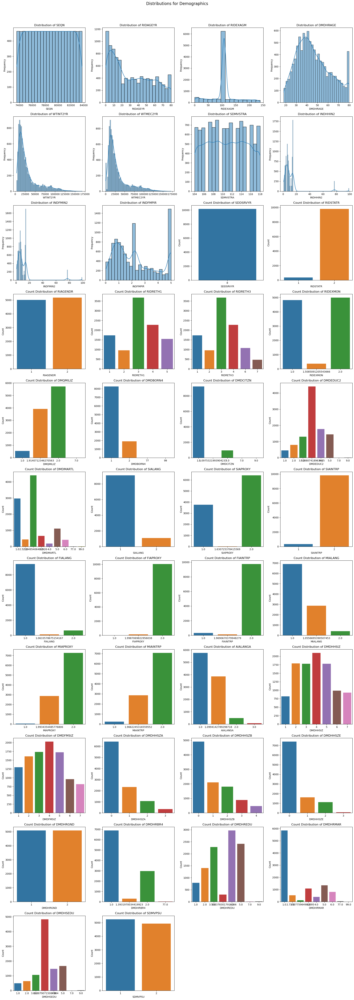

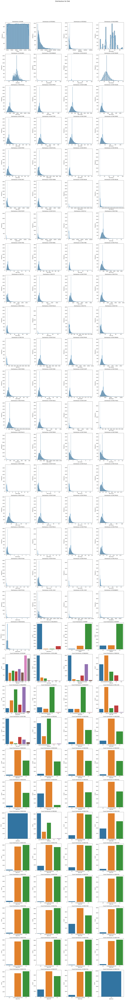

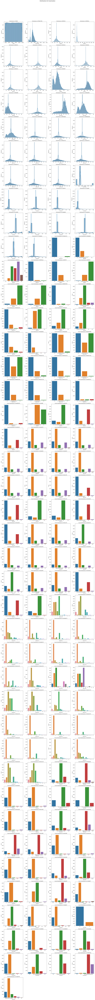

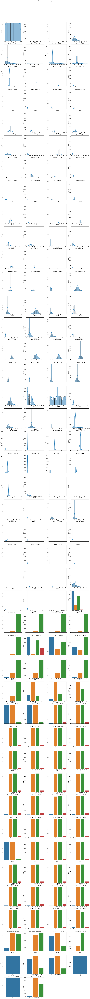

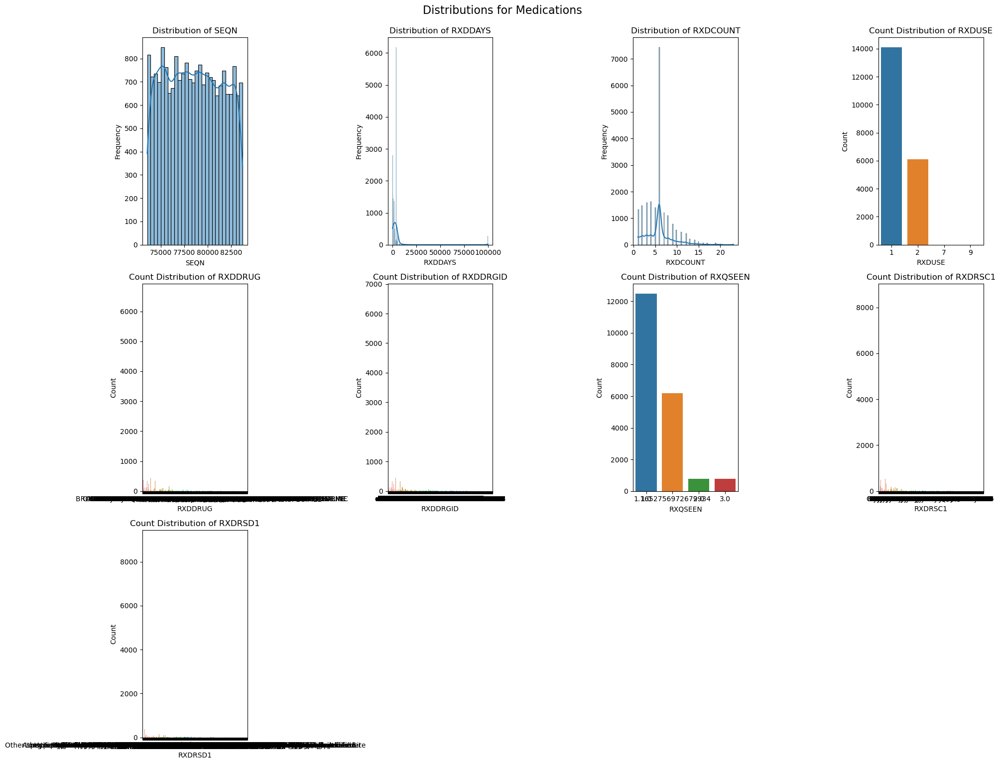

In [22]:
def plot_distributions(name, df, continuous_vars, categorical_vars):
    # Calculate the number of subgraphs needed
    num_plots = len(continuous_vars) + len(categorical_vars)
    num_rows = (num_plots // 4) + (num_plots % 4 > 0)
    
    fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(20, 5 * num_rows))
    axes = axes.flatten()
    
    # Draw a histogram of continuous variables
    for i, var in enumerate(continuous_vars):
        sns.histplot(df[var], kde=True, ax=axes[i])
        axes[i].set_title(f"Distribution of {var}")
        axes[i].set_xlabel(var)
        axes[i].set_ylabel("Frequency")
    
    # Draw a bar chart of categorical variables
    for i, var in enumerate(categorical_vars, start=len(continuous_vars)):
        sns.countplot(x=df[var], ax=axes[i])
        axes[i].set_title(f"Count Distribution of {var}")
        axes[i].set_xlabel(var)
        axes[i].set_ylabel("Count")
    
    # Hide extra sub-images
    for j in range(num_plots, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.suptitle(f"Distributions for {name}", fontsize=16, y=1.02)
    plt.show()

# Loop through the dictionary and process each dataset
for name, df in datasets_cleaned.items():
    continuous_vars, categorical_vars = classify_variables(df)
    plot_distributions(name, df, continuous_vars, categorical_vars)

Because there is too much data, the overall operation is very slow, so first select variables that are helpful for association analysis, clustering and predictive modeling. 

**Select key categories**: Select variables related to core categories such as health, demographics, and dietary habits from the columns of each dataset. We can select according to the following categories:
- **Demographics**: Select variables related to age (`RIDAGEYR`), gender (`RIAGENDR`), race (`RIDRETH1`, `RIDRETH3`), education level (`DMDEDUC2`), and household income (`INDHHIN2`, `INDFMIN2`, `INDFMPIR`).
- **Diet variables**: Select nutritional intake variables such as daily intake, calories (`DR1TKCAL`), protein (`DR1TPROT`), carbohydrates (`DR1TCARB`), and fat (`DR1TTFAT`) to study the relationship between diet and health.
- **Examination variables**: Select variables related to physical conditions such as body mass index (BMI) (`BMXBMI`), blood pressure (`BPXSY1`, `BPXDI1`).
- **Laboratory variables**: Include variables closely related to health risks such as cholesterol level (`LBXSCH`), blood sugar (`LBXGLU`), and liver function (`LBXSAPSI`, `LBXSASSI`).
- **Questionnaire variables**: Include lifestyle variables such as smoking habits (`SMQ020`), drinking habits (`ALQ101`), and physical activity (`PAQ605`, `PAQ620`).

In [56]:
# Select variables in each dataset
demographics_vars = datasets_cleaned['Demographics'][['SEQN', 'RIDAGEYR', 'RIAGENDR', 'RIDRETH1', 'DMDCITZN', 'DMDEDUC2', 'DMDMARTL', 'INDHHIN2']]
diet_vars = datasets_cleaned['Diet'][['SEQN', 'DR1TKCAL', 'DR1TPROT', 'DR1TCARB', 'DR1TTFAT', 'DR1TCHOL', 'DR1TSODI', 'DR1TFIBE']]
examination_vars = datasets_cleaned['Examination'][['SEQN', 'BMXBMI', 'BPXSY1', 'BPXDI1', 'BMXWT', 'BMXHT', 'BMXWAIST']]
laboratory_vars = datasets_cleaned['Laboratory'][['SEQN', 'LBXSCH', 'LBXSAPSI', 'LBXSASSI', 'LBXSTR', 'LBXSCR']]
questionnaire_vars = datasets_cleaned['Questionnaire'][['SEQN', 'SMQ020', 'ALQ101', 'PAQ605', 'PAQ620', 'DBQ700']]

# Merge the selected variables into a new dataset
merged_data = demographics_vars.merge(diet_vars, on='SEQN', how='inner')\
                               .merge(examination_vars, on='SEQN', how='inner')\
                               .merge(laboratory_vars, on='SEQN', how='inner')\
                               .merge(questionnaire_vars, on='SEQN', how='inner')

# Output the basic information of the merged data set
print("Merged Data Shape:", merged_data.shape)
print(merged_data.info())

Merged Data Shape: (9813, 31)
<class 'pandas.core.frame.DataFrame'>
Int64Index: 9813 entries, 0 to 9812
Data columns (total 31 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   SEQN      9813 non-null   int64  
 1   RIDAGEYR  9813 non-null   int64  
 2   RIAGENDR  9813 non-null   int64  
 3   RIDRETH1  9813 non-null   int64  
 4   DMDCITZN  9813 non-null   float64
 5   DMDEDUC2  9813 non-null   float64
 6   DMDMARTL  9813 non-null   float64
 7   INDHHIN2  9813 non-null   float64
 8   DR1TKCAL  9813 non-null   float64
 9   DR1TPROT  9813 non-null   float64
 10  DR1TCARB  9813 non-null   float64
 11  DR1TTFAT  9813 non-null   float64
 12  DR1TCHOL  9813 non-null   float64
 13  DR1TSODI  9813 non-null   float64
 14  DR1TFIBE  9813 non-null   float64
 15  BMXBMI    9813 non-null   float64
 16  BPXSY1    9813 non-null   float64
 17  BPXDI1    9813 non-null   float64
 18  BMXWT     9813 non-null   float64
 19  BMXHT     9813 non-null   float64
 20  

### Variable Description

#### Demographics
- **SEQN**: Unique Identifier
- **RIDAGEYR**: Age (years)
- **RIAGENDR**: Gender (1=Male, 2=Female)
- **RIDRETH1**: Race/Ethnicity (1=Mexican American, 2=Other Hispanic, 3=Non-Hispanic White, 4=Non-Hispanic Black, 5=Other)
- **DMDCITZN**: Citizenship (1=US Citizen, 2=Non-US Citizen)
- **DMDEDUC2**: Education (1=Less than 9th grade, 2=9-11th grade, 3=High school graduate, 4=Some college, 5=College graduate and above)
- **DMDMARTL**: Marital status (1=Married, 2=Divorced, 3=Widowed, 4=Never married, 5=Cohabiting)
- **INDHHIN2**: Household income (1=poor, 2=low income, 3=middle income, 4=high income)

#### Diet
- **SEQN**: Unique identifier
- **DR1TKCAL**: Total energy intake (kcal)
- **DR1TPROT**: Protein intake (g)
- **DR1TCARB**: Carbohydrate intake (g)
- **DR1TTFAT**: Total fat intake (g)
- **DR1TCHOL**: Cholesterol intake (mg)
- **DR1TSODI**: Sodium intake (mg)
- **DR1TFIBE**: Dietary fiber intake (g)

#### Examination
- **SEQN**: Unique identifier
- **BMXBMI**: Body mass index (BMI)
- **BPXSY1**: Systolic blood pressure (first measurement, mmHg)
- **BPXDI1**: Diastolic blood pressure (first measurement, mmHg)
- **BMXWT**: Weight (kg)
- **BMXHT**: Height (cm)
- **BMXWAIST**: Waist circumference (cm)

#### Laboratory
- **SEQN**: Unique identifier
- **LBXSCH**: Serum cholesterol (mg/dL)
- **LBXGLU**: Blood glucose (mg/dL)
- **LBXSAPSI**: Serum low-density lipoprotein cholesterol (mg/dL)
- **LBXSASSI**: Serum high-density lipoprotein cholesterol (mg/dL)
- **LBXSTR**: Serum triglycerides (mg/dL)
- **LBXSCR**: Serum creatinine (mg/dL)

#### Questionnaire
- **SEQN**: Unique identifier
- **SMQ020**: Smoking status (1=current smoker, 2=former smoker, 3=never smoker)
- **ALQ101**: Frequency of drinking (1=daily, 2=several times a week, 3=several times a month, 4=rarely or never)
- **PAQ605**: Frequency of physical activity (1=daily, 2=several times a week, 3=several times a month, 4=rarely or never)
- **PAQ620**: Intensity of physical activity (1=light, 2=moderate, 3=heavy)
- **DBQ700**: Eating habits (1=very healthy, 2=healthy, 3=not too healthy, 4=unhealthy)

In [36]:
classify_variables(merged_data)
print(continuous_vars)
print(categorical_vars)

['SEQN', 'RIDAGEYR', 'INDHHIN2', 'DR1TKCAL', 'DR1TPROT', 'DR1TCARB', 'DR1TTFAT', 'DR1TCHOL', 'DR1TSODI', 'DR1TFIBE', 'BMXBMI', 'BPXSY1', 'BPXDI1', 'BMXWT', 'BMXHT', 'BMXWAIST', 'LBXSCH', 'LBXSAPSI', 'LBXSASSI', 'LBXSTR', 'LBXSCR']
['RIAGENDR', 'RIDRETH1', 'DMDCITZN', 'DMDEDUC2', 'DMDMARTL', 'SMQ020', 'ALQ101', 'PAQ605', 'PAQ620', 'DBQ700']


In [ ]:
# Save the merged dataset if needed
# merged_data.to_csv('merged_data.csv', index=False)

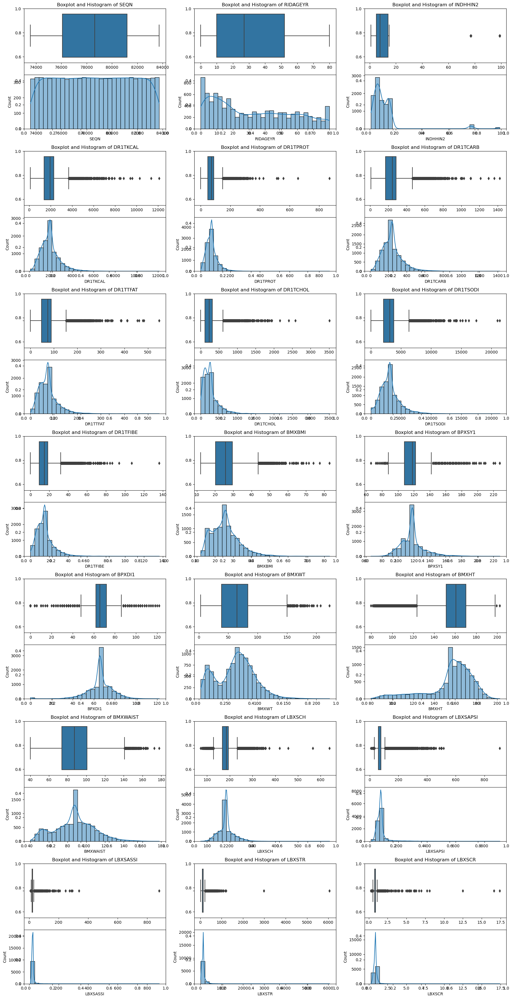

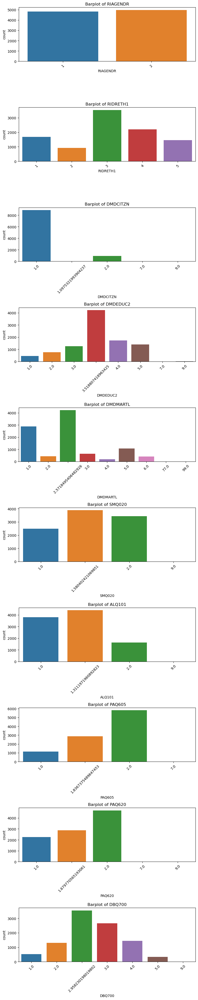

In [28]:
# Generate box plots and histograms of continuous variables
def plot_continuous_vars(data, continuous_vars):
    num_plots = len(continuous_vars)
    num_rows = (num_plots // 3) + (num_plots % 3 > 0)
    
    fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(18, 5 * num_rows))
    axes = axes.flatten()
    
    for i, var in enumerate(continuous_vars):
        ax = axes[i]
        
        ax.set_title(f'Boxplot and Histogram of {var}')
        
        # Adjust inset axes for boxplot and histogram with larger size
        ax1 = ax.inset_axes([0, 0.6, 1, 0.4])
        sns.boxplot(data=data, x=var, ax=ax1)
        ax1.set_title('')
        ax1.set_xlabel('')
        
        ax2 = ax.inset_axes([0, 0, 1, 0.55])
        sns.histplot(data[var], bins=30, kde=True, ax=ax2)
        ax2.set_title('')
        ax2.tick_params(axis='x', rotation=45)  # Rotate x-axis labels for histogram
        
    for j in range(num_plots, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout(pad=2.0)  # Add more padding between subplots
    plt.show()


# Generate a bar chart of categorical variables
def plot_categorical_vars(data, categorical_vars):
    num_plots = len(categorical_vars)
    num_rows = (num_plots // 3) + (num_plots % 3 > 0)
    
    fig, axes = plt.subplots(nrows=num_plots, ncols=1, figsize=(8, 4 * num_plots))
    if num_plots == 1:
        axes = [axes]
    
    for i, var in enumerate(categorical_vars):
        ax = axes[i]
        
        sns.countplot(data=data, x=var, ax=ax)
        ax.set_title(f'Barplot of {var}')
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    
    plt.tight_layout()
    plt.show()

plot_continuous_vars(merged_data, continuous_vars)
plot_categorical_vars(merged_data, categorical_vars)

According to the image, we can analyze the distribution and outliers of each variable one by one:

1. **SEQN**: This is an identifier and does not require outlier inspection and processing.

2. **RIDAGEYR (age)**: The distribution of age is reasonable and there are no obvious outliers, so the original data can be kept.

3. **INDHHIN2 (household income)**: There are some high outliers in the household income distribution, especially around 80 and 100. It is recommended to use upper limit truncation or percentile to deal with these high-income outliers to reduce the impact on the overall analysis.

4. **DR1TKCAL (daily total calorie intake)**: There are many high outliers, and values ​​over 4000 are significantly higher than the main distribution. These outliers can be removed or adjusted using the IQR method or setting an upper limit.

5. **DR1TPROT (protein intake)**: This variable also has obvious outliers, especially some extremely high values ​​(>200). These outliers can be handled by IQR or percentile methods.

6. **DR1TCARB (Carbohydrate Intake)**: There are also many high outliers. You can use the IQR method or percentile processing, or logarithm transformation of the data as needed to reduce the impact of outliers.

7. **DR1TTFAT (Total Fat Intake)**: This variable has many high value outliers, and you can take a similar treatment method as the carbohydrates above.

8. **DR1TCHOL (Cholesterol Intake)**: There are some high outliers. It is recommended to use the IQR method or upper limit truncation to ensure that it does not overly affect the analysis results.

9. **DR1TSODI (Sodium Intake)**: The distribution of this variable has many high outliers. You can remove the outliers by the IQR method or perform upper limit truncation.

10. **DR1TFIBE (Fiber Intake)**: There are some high outliers in this variable. You can use the IQR method or upper limit truncation to adjust these values.

11. **BMXBMI (Body Mass Index)**: There are some high value outliers in the distribution of BMI. It is recommended to cut off these outliers according to the healthy range of IQR or BMI (for example, values ​​greater than 40 may be abnormal).

12. **BPXSY1 (systolic blood pressure)** and **BPXDI1 (diastolic blood pressure)**: There are some high outliers in these two blood pressure variables, and the high outliers can be cut off according to the healthy range of blood pressure (for example, systolic blood pressure greater than 180 and diastolic blood pressure greater than 120).

13. **BMXWT (weight)**: There are some high-value anomalies in the distribution of weight. It is recommended to use the IQR method or cut off according to the weight range (for example, greater than 150 kg may be abnormal).

14. **BMXHT (height)**: The height distribution is relatively normal. Unless special standards are required, it is generally not necessary to remove outliers.

15. **BMXWAIST (waist circumference)**: There are some high-value anomalies in this variable. It can be truncated or IQR processed according to the healthy range of waist circumference (for example, greater than 120 cm may be abnormal).

16. **LBXSCH (total cholesterol)**: This variable has some high abnormal values. It is recommended to use the IQR method or set an upper limit to handle these abnormal values.

17. **LBXSAPSI (alkaline phosphatase)** and **LBXSASSI (aspartate aminotransferase)**: These liver function-related variables have some extremely high abnormal values, which can be handled according to the medical reference range or IQR method.

18. **LBXSTR (triglycerides)**: There are many high abnormal values ​​in the distribution of triglycerides. The high abnormal values ​​can be truncated using the IQR method or according to the healthy range of triglycerides.

19. **LBXSCR (creatinine)**: The distribution of creatinine has some high abnormal values. These abnormal values ​​can be handled according to the medical reference range or IQR method.


## Handle outliers

In [29]:
# Function to calculate and remove outliers
def remove_outliers(df, columns):
    for col in columns:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        df = df[(df[col] >= lower_bound) & (df[col] <= upper_bound)]
    return df

merged_capped_data = remove_outliers(merged_data, continuous_vars)

In [57]:
merged_capped_data.head()

,SEQN,RIDAGEYR,RIAGENDR,RIDRETH1,DMDCITZN,DMDEDUC2,DMDMARTL,INDHHIN2,DR1TKCAL,DR1TPROT,...,LBXSCH,LBXSAPSI,LBXSASSI,LBXSTR,LBXSCR,SMQ020,ALQ101,PAQ605,PAQ620,DBQ700
6,73563,0,1,3,1.0,3.518807,2.57185,15.0,1964.538624,74.536708,...,184.505877,78.578907,25.117845,143.084288,0.880172,1.580402,1.311197,1.836738,1.679771,2.95823
14,73573,10,1,4,1.0,3.518807,2.57185,8.0,1964.538624,74.536708,...,184.505877,78.578907,25.117845,143.084288,0.880172,1.580402,1.311197,1.836738,1.679771,2.95823
16,73575,1,1,4,1.0,3.518807,2.57185,3.0,868.000000,21.600000,...,184.505877,78.578907,25.117845,143.084288,0.880172,1.580402,1.311197,1.836738,1.679771,2.95823
19,73578,18,1,1,1.0,3.518807,2.57185,5.0,955.000000,81.610000,...,184.505877,78.578907,25.117845,143.084288,0.880172,2.000000,2.000000,1.000000,1.000000,2.00000
23,73582,23,2,4,1.0,4.000000,6.00000,3.0,1964.538624,74.536708,...,184.505877,78.578907,25.117845,143.084288,0.880172,2.000000,1.311197,2.000000,1.000000,3.00000


**After processing the outliers, the continuous variables of the merged data set are standardized.**
#### Standardization
To ensure that the scale of each feature is consistent during model training, we standardized all continuous variables. Standardization is a common data preprocessing technique that can eliminate the impact of dimensions and scales between different features by converting the data into a standard normal distribution with a mean of 0 and a standard deviation of 1. After standardization, all features are on the same scale, which helps improve the convergence speed and performance of the model, especially when using optimization algorithms such as gradient descent. In addition, standardization can prevent certain features from having too much impact on the model due to their large numerical range, thereby ensuring the stability and accuracy of the model.

In [58]:
from sklearn.preprocessing import StandardScaler

# Copy data to avoid affecting the original data
standarded_data = merged_capped_data.copy()

# Standardize continuous variables
scaler = StandardScaler()
standarded_data[continuous_vars] = scaler.fit_transform(merged_capped_data[continuous_vars])


standarded_data.head()

,SEQN,RIDAGEYR,RIAGENDR,RIDRETH1,DMDCITZN,DMDEDUC2,DMDMARTL,INDHHIN2,DR1TKCAL,DR1TPROT,...,LBXSCH,LBXSAPSI,LBXSASSI,LBXSTR,LBXSCR,SMQ020,ALQ101,PAQ605,PAQ620,DBQ700
6,-1.692682,-0.642962,1,3,1.0,3.518807,2.57185,1.529366,0.798316,0.853561,...,0.0,1.421085e-14,-3.552714e-15,2.842171e-14,-1.110223e-16,1.580402,1.311197,1.836738,1.679771,2.95823
14,-1.689310,0.386024,1,4,1.0,3.518807,2.57185,-0.035615,0.798316,0.853561,...,0.0,1.421085e-14,-3.552714e-15,2.842171e-14,-1.110223e-16,1.580402,1.311197,1.836738,1.679771,2.95823
16,-1.688636,-0.540063,1,4,1.0,3.518807,2.57185,-1.153459,-1.224580,-1.411065,...,0.0,1.421085e-14,-3.552714e-15,2.842171e-14,-1.110223e-16,1.580402,1.311197,1.836738,1.679771,2.95823
19,-1.687625,1.209212,1,1,1.0,3.518807,2.57185,-0.706321,-1.064082,1.156156,...,0.0,1.421085e-14,-3.552714e-15,2.842171e-14,-1.110223e-16,2.000000,2.000000,1.000000,1.000000,2.00000
23,-1.686276,1.723705,2,4,1.0,4.000000,6.00000,-1.153459,0.798316,0.853561,...,0.0,1.421085e-14,-3.552714e-15,2.842171e-14,-1.110223e-16,2.000000,1.311197,2.000000,1.000000,3.00000


**Next, we perform One-Hot Encoding on the categorical variables in the dataset, so that they can be easily input into the machine learning model for analysis in the future. One-Hot Encoding converts each category into an independent binary feature, which allows the model to better handle these discrete values.**
#### One-Hot Encoding
For categorical variables, we used One-Hot Encoding to convert them into binary vectors. One-Hot Encoding is a technique that converts categorical variables into numerical form by creating new binary features to represent each category.
The main purpose of One-Hot Encoding is to prevent the model from treating categorical variables as ordered variables, thereby introducing unnecessary bias. By converting categorical variables into binary vectors, the model can better understand and process these variables without being affected by the order of the categories. In addition, One-Hot Encoding also enables the model to take advantage of linear models and other distance-based algorithms, as these algorithms usually require the input features to be in numerical form.

In [59]:
encoded_data = pd.get_dummies(standarded_data, columns=categorical_vars, drop_first=True)

encoded_data.head()

,SEQN,RIDAGEYR,INDHHIN2,DR1TKCAL,DR1TPROT,DR1TCARB,DR1TTFAT,DR1TCHOL,DR1TSODI,DR1TFIBE,...,ALQ101_2.0,PAQ605_1.8367375489647453,PAQ605_2.0,PAQ620_1.679770565193061,PAQ620_2.0,DBQ700_2.0,DBQ700_2.958230198019802,DBQ700_3.0,DBQ700_4.0,DBQ700_5.0
6,-1.692682,-0.642962,1.529366,0.798316,0.853561,0.574757,0.770706,0.823942,0.830129,0.699380,...,0,1,0,1,0,0,1,0,0,0
14,-1.689310,0.386024,-0.035615,0.798316,0.853561,0.574757,0.770706,0.823942,0.830129,0.699380,...,0,1,0,1,0,0,1,0,0,0
16,-1.688636,-0.540063,-1.153459,-1.224580,-1.411065,-1.042959,-1.100971,-1.156543,-1.189362,-1.350335,...,0,1,0,1,0,0,1,0,0,0
19,-1.687625,1.209212,-0.706321,-1.064082,1.156156,-1.194409,-1.703126,-0.033422,-0.072145,0.757380,...,1,0,0,0,0,1,0,0,0,0
23,-1.686276,1.723705,-1.153459,0.798316,0.853561,0.574757,0.770706,0.823942,0.830129,0.699380,...,0,0,1,0,0,0,0,1,0,0


In [38]:
encoded_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2334 entries, 6 to 9811
Data columns (total 52 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   SEQN                         2334 non-null   float64
 1   RIDAGEYR                     2334 non-null   float64
 2   INDHHIN2                     2334 non-null   float64
 3   DR1TKCAL                     2334 non-null   float64
 4   DR1TPROT                     2334 non-null   float64
 5   DR1TCARB                     2334 non-null   float64
 6   DR1TTFAT                     2334 non-null   float64
 7   DR1TCHOL                     2334 non-null   float64
 8   DR1TSODI                     2334 non-null   float64
 9   DR1TFIBE                     2334 non-null   float64
 10  BMXBMI                       2334 non-null   float64
 11  BPXSY1                       2334 non-null   float64
 12  BPXDI1                       2334 non-null   float64
 13  BMXWT             

### In order to conduct correlation analysis and multivariate visualization between variables

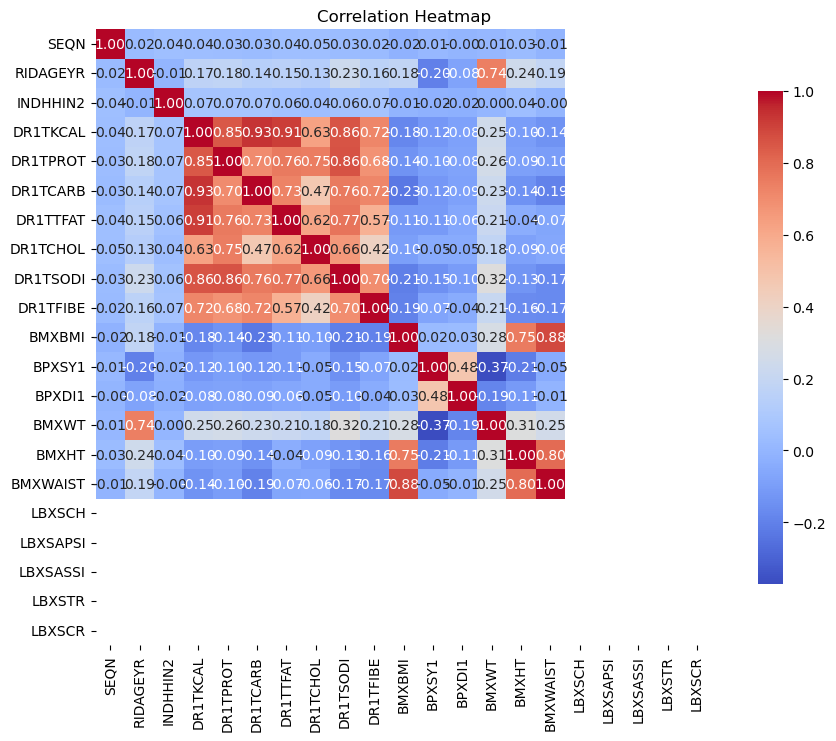

In [39]:
# Define a function to draw a correlation heatmap
def plot_correlation_heatmap(data, continuous_vars):
    """
    Draw a heatmap of the correlation of continuous variables in the given data.

    Parameters:
    data (DataFrame): dataset
    continuous_vars (list): list of column names of continuous variables
    """
   
    correlation_matrix = data[continuous_vars].corr()
 
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', square=True, cbar_kws={'shrink': .8})
    plt.title('Correlation Heatmap')
    plt.show()


plot_correlation_heatmap(encoded_data, continuous_vars)

In this correlation heatmap, each square represents the correlation between two variables, and the correlation coefficient ranges from -1 to 1:

- **Color and correlation strength**: The closer the color is to red (1), the stronger the positive correlation is; the closer it is to blue (-1), the stronger the negative correlation is. Colors close to white or light blue indicate almost no correlation (0).

- **Interpreting correlation**:
- **Positive correlation**: For example, the correlation coefficient of `DR1TPROT` (protein intake) and `DR1TCARB` (carbohydrate intake) is 0.85, indicating that there is a strong positive correlation between them, indicating that the trends of protein intake and carbohydrate intake are similar.

- **Negative correlation**: Negative correlation will be blue in color, but there is no significant negative correlation in this figure.
- **Almost no correlation**: For example, the coefficient of `SEQN` and other variables is close to 0, indicating almost no relationship. This is reasonable because `SEQN` is an identifier and has nothing to do with the actual data.

- **Observation points**:
- **Highly correlated** variables, such as `DR1TKCAL` (daily caloric intake), show a high positive correlation with `DR1TPROT`, `DR1TCARB` and `DR1TTFAT`, indicating that these nutritional intake indicators are closely related to each other and may affect similar health outcomes.
- **Moderate correlation**: For example, `BMXBMI` (BMI) and `BMXWT` (weight) have a certain correlation (0.75), indicating that BMI and weight are logically consistent and in line with the intuition of health analysis.
- **Blood pressure correlation**: `BPXSY1` (systolic blood pressure) and `BPXDI1` (diastolic blood pressure) have a positive correlation of 0.48, indicating that there is a certain correlation between the two blood pressure indicators, but not a complete correlation.

- **Application and next steps**:
- Cluster analysis can be performed based on highly correlated variables to group people, such as `DR1TPROT`, `DR1TCARB` and `DR1TTFAT` can be used to identify eating habits.
- For low correlation variables, such as those with little correlation with health-related variables, consider whether to evaluate their importance in subsequent analysis.

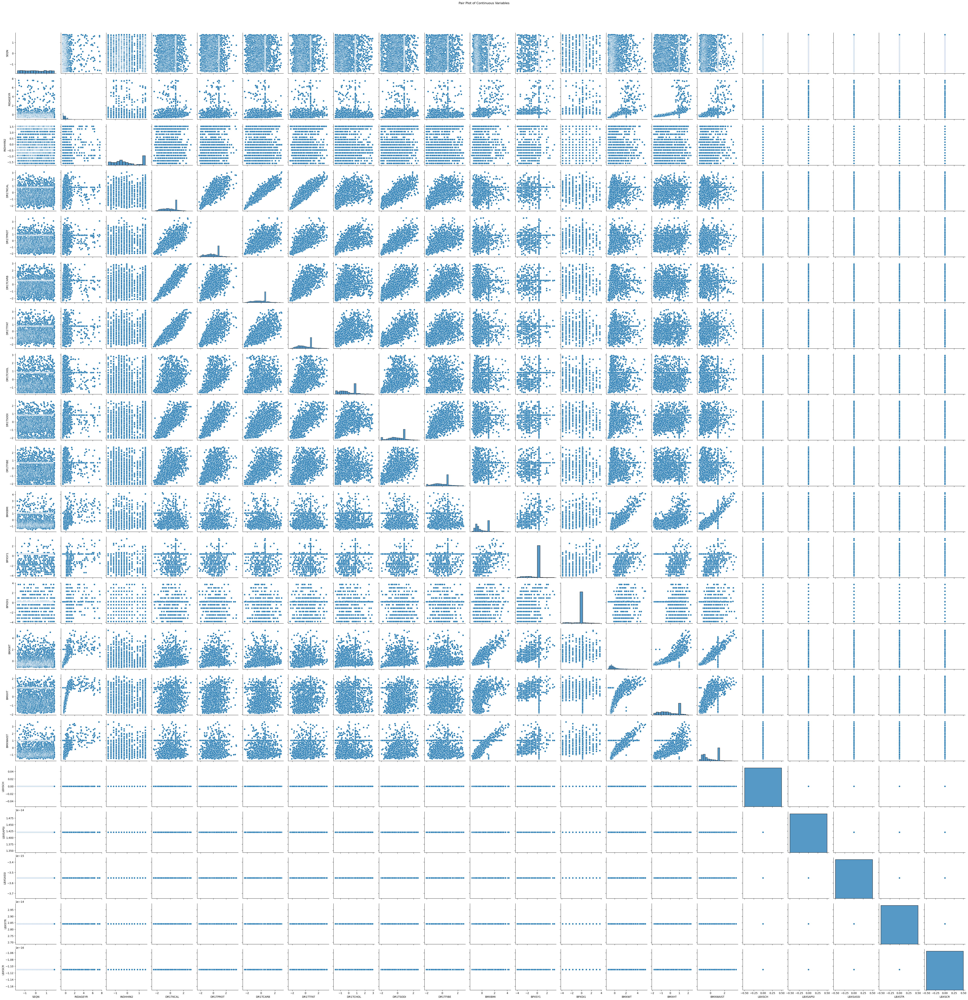

In [40]:
def plot_pair_plot(data, continuous_vars):
    sns.pairplot(data[continuous_vars], diag_kind='hist')
    plt.suptitle('Pair Plot of Continuous Variables', y=1.02)
    plt.show()
    
plot_pair_plot(standarded_data, continuous_vars)

### Next, we need to perform cluster analysis. We can do it by following the steps below:

1. K-means clustering
Use the K-means algorithm to cluster the data. We will use the Elbow Method and Silhouette Score to select the optimal number of clusters `k`.

2. DBSCAN clustering
Use the DBSCAN algorithm to cluster the data. This algorithm does not require the number of clusters to be specified in advance and is suitable for processing data containing noise and outliers.

3. Visualization of clustering results
We can use 2D or 3D scatter plots to display the clustering results and analyze and explain the characteristics of each cluster.

###  1. **K-means clustering**:
- The `kmeans_clustering` function helps to choose the best `k` value through the Elbow Method and Silhouette Score.
- The function will plot the elbow method and silhouette coefficient to help choose the most suitable number of clusters.
- The cluster labels of the best `k` value will be returned by `kmeans_labels`, and the clustering results will be displayed using a 2D scatter plot after PCA dimensionality reduction.

In [41]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt


# Define K-means clustering function
def kmeans_clustering(data, continuous_vars, max_k=10, use_pca=False):
    # Calculate SSE (elbow method) and silhouette coefficient for different K values
    sse = []
    silhouette_scores = []
    for k in range(2, max_k + 1):
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(data[continuous_vars])
        sse.append(kmeans.inertia_)
        silhouette_scores.append(silhouette_score(data[continuous_vars], kmeans.labels_))
    
    # Draw the elbow method graph
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(range(2, max_k + 1), sse, marker='o')
    plt.title("Elbow Method")
    plt.xlabel("Number of clusters")
    plt.ylabel("SSE")
    
    # Draw the silhouette coefficient graph
    plt.subplot(1, 2, 2)
    plt.plot(range(2, max_k + 1), silhouette_scores, marker='o')
    plt.title("Silhouette Score")
    plt.xlabel("Number of clusters")
    plt.ylabel("Silhouette Score")
    plt.show()

    # K-means clustering based on the best k value
    best_k = silhouette_scores.index(max(silhouette_scores)) + 2
    kmeans = KMeans(n_clusters=best_k, random_state=42)
    kmeans_labels = kmeans.fit_predict(data[continuous_vars])
    
    # Optionally perform PCA dimensionality reduction for visualization
    if use_pca:
        pca = PCA(n_components=2)
        pca_result = pca.fit_transform(data[continuous_vars])
        plt.figure(figsize=(8, 6))
        plt.scatter(pca_result[:, 0], pca_result[:, 1], c=kmeans_labels, cmap='viridis')
        plt.title(f'K-means Clustering with k={best_k} (PCA Visualization)')
        plt.xlabel('PCA Component 1')
        plt.ylabel('PCA Component 2')
        plt.colorbar(label='Cluster')
        plt.show()
    else:
        print(f"K-means Clustering with k={best_k} completed.")
    
    return kmeans_labels


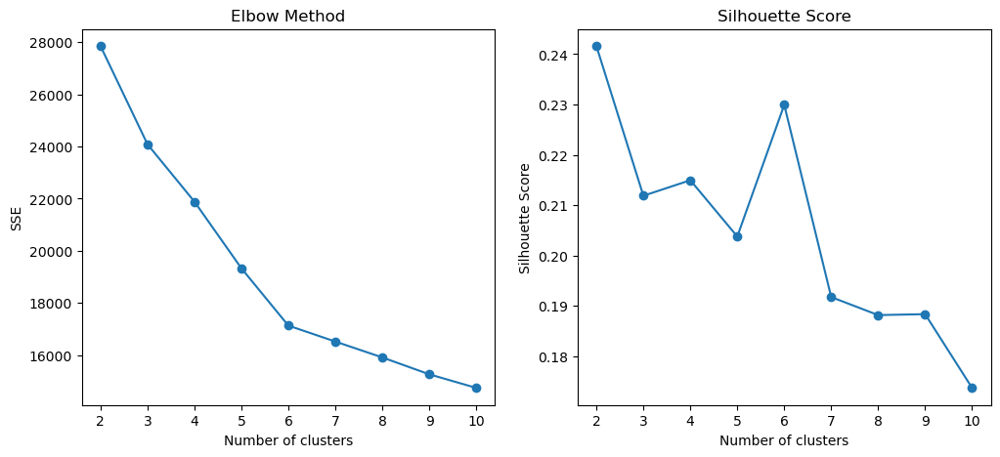

K-means Clustering with k=2 completed.


In [43]:
kmeans_labels = kmeans_clustering(encoded_data, continuous_vars, max_k=10, use_pca=False)

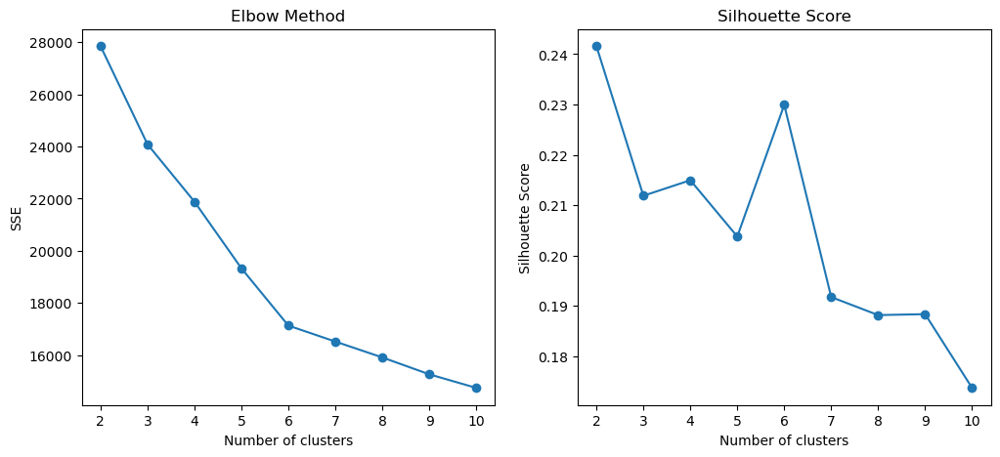

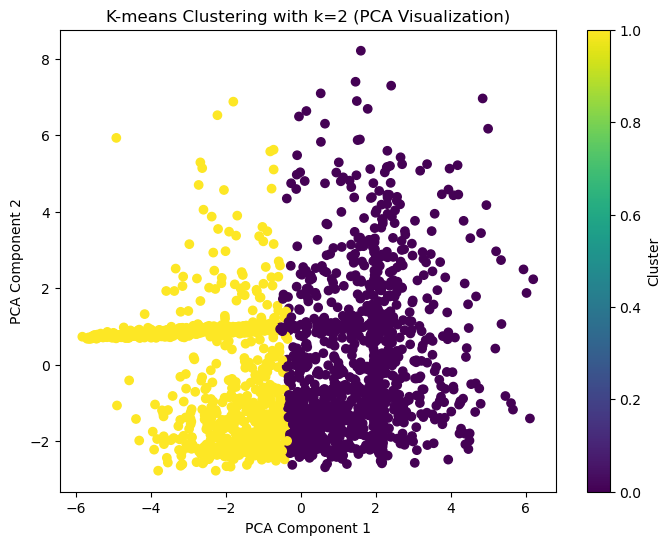

In [45]:
kmeans_labels = kmeans_clustering(encoded_data, continuous_vars, max_k=10, use_pca=True)

The 2D scatter plot after PCA dimensionality reduction helps us understand the distribution of clusters in two-dimensional space:

1. **Elbow Method** and **Silhouette Score** charts: These two charts are used to determine the optimal number of clusters `k`.
- **Elbow Method** chart shows the SSE (Sum of Squared Errors within Clusters) for different `k` values. We will observe that as `k` increases, the SSE gradually decreases. Usually, the best `k` value is where the "elbow" appears, that is, the point where the SSE begins to gradually slow down. From the figure, `k=2` seems to be a suitable choice because the rate of decrease of SSE gradually slows down after this point.
- **Silhouette Score** chart reflects the closeness and separation of clusters. A higher silhouette score indicates a better clustering effect. In this figure, `k=2` also shows a higher silhouette score, supporting `k=2` as a reasonable choice.

2. **2D scatter plot after PCA dimensionality reduction**: The figure shows the results of `k=2` clustering after using PCA to reduce the data to two dimensions.
- Each point represents a sample, and the color coding indicates different clusters.
- **Explanation**: From this figure, we can see two color-separated areas, representing two clusters of `k-means` clustering. Although the two-dimensional scatter plot of PCA cannot fully preserve the complex structure of the original data, it can help us intuitively understand the degree of separation between clusters. In this case, the two clusters are roughly separated, indicating that these samples have obvious differences in the selected feature dimensions.

3. **Next step**:
- We can further analyze the feature mean of each cluster to determine which features play a key role in the division of clusters. By looking at the distribution of each feature in each cluster, the practical significance of clustering can be better explained.
- Combining the scatter plot after dimensionality reduction and the feature mean analysis of clustering, we can determine whether the clustering meets expectations and explore the practical application value of this clustering analysis.

             SEQN  RIDAGEYR  INDHHIN2  DR1TKCAL  DR1TPROT  DR1TCARB  DR1TTFAT  \
Cluster                                                                         
0        0.040657  0.149321  0.054420  0.673126  0.629444  0.604235  0.614926   
1       -0.062600 -0.229912 -0.083792 -1.036424 -0.969166 -0.930350 -0.946812   

         DR1TCHOL  DR1TSODI  DR1TFIBE  ...    BPXSY1    BPXDI1     BMXWT  \
Cluster                                ...                                 
0        0.501654  0.632414  0.535373  ... -0.094960 -0.078960  0.199770   
1       -0.772406 -0.973739 -0.824323  ...  0.146212  0.121576 -0.307589   

            BMXHT  BMXWAIST  LBXSCH      LBXSAPSI      LBXSASSI        LBXSTR  \
Cluster                                                                         
0       -0.074568 -0.094272     0.0  1.421085e-14 -3.552714e-15  2.842171e-14   
1        0.114814  0.145152     0.0  1.421085e-14 -3.552714e-15  2.842171e-14   

               LBXSCR  
Cluster              

<Figure size 1200x800 with 0 Axes>

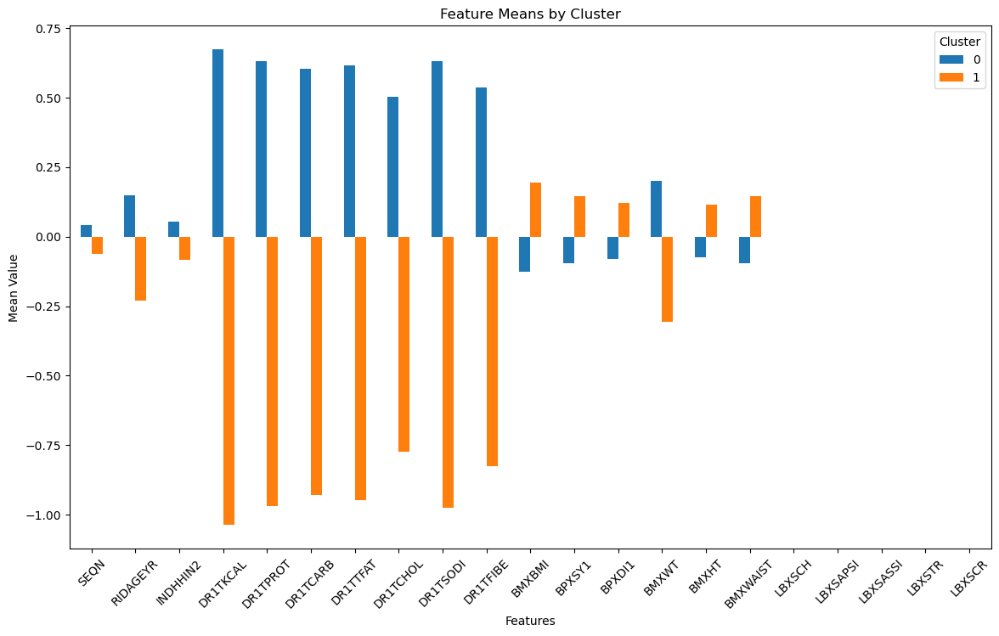

In [47]:
def analyze_cluster_means(encoded_data, continuous_vars, kmeans_labels):
    """
    Analyze and visualize the feature means for each cluster.

    :param encoded_data: DataFrame containing the data
    :param continuous_vars: List of continuous variables
    :param kmeans_labels: Cluster labels from K-means clustering
    """
    # Add cluster labels to the normalized data
    encoded_data['Cluster'] = kmeans_labels

    # Calculate the feature mean for each cluster
    cluster_means = encoded_data.groupby('Cluster')[continuous_vars].mean()

    # Print or view feature mean
    print(cluster_means)

    # Visualize the feature mean of each cluster
    plt.figure(figsize=(12, 8))
    cluster_means.T.plot(kind='bar', figsize=(14, 8))
    plt.title('Feature Means by Cluster')
    plt.ylabel('Mean Value')
    plt.xlabel('Features')
    plt.xticks(rotation=45)
    plt.legend(title='Cluster')
    plt.show()

analyze_cluster_means(encoded_data, continuous_vars, kmeans_labels)

In this bar chart, the difference in the mean of each feature in different clusters shows which features play an important role in distinguishing clusters. The following are the analysis steps:

1. **Observe the feature mean of each cluster**:
- If the mean difference of different clusters on a certain feature is large, it means that the feature is more important to distinguish the two clusters.
- For example, the mean difference of dietary variables such as `DR1TKCAL`, `DR1TPROT`, `DR1TCARB`, and `DR1TTFAT` in the figure is large in the two clusters, indicating that these features may reflect differences in dietary habits.

2. **Explain the characteristics of each cluster**:
- **Cluster 0**: This cluster has a higher mean in dietary features such as `DR1TKCAL`, `DR1TPROT`, and `DR1TCARB`, which may represent a group with high calorie, high protein, and high carbohydrate intake.
- **Cluster 1**: In contrast, Cluster 1 has a lower mean in these dietary variables, which may represent a group with relatively low calorie, low protein, and low carbohydrate intake.

3. **Practical significance of clustering**:
- It can be speculated that cluster 0 may represent a group with richer eating habits or higher intake, while cluster 1 represents a group with controlled diet or lower intake. This clustering may help distinguish dietary patterns in nutrition research and analyze their relationship with health outcomes.
- Further analysis can explore the association of these clusters with health indicators (such as `BMXBMI`, `BPXSY1`, etc.) to observe whether there are obvious health differences.

4. **Application value**:
- If health risk analysis is planned, cluster 0 and cluster 1 can represent high-intake and low-intake groups, respectively, to help identify which groups are more likely to face certain health risks.
- In addition, this grouping can serve as the basis for feature engineering, adding cluster labels to the prediction model to enhance the model's predictive ability for health outcomes.


### 2. **DBSCAN clustering**:
- The `dbscan_clustering` function uses the DBSCAN clustering algorithm to cluster density-related samples.
- The density threshold can be adjusted through the `eps` and `min_samples` parameters.
- The function will display the clustering results using a 2D scatter plot after PCA dimensionality reduction.

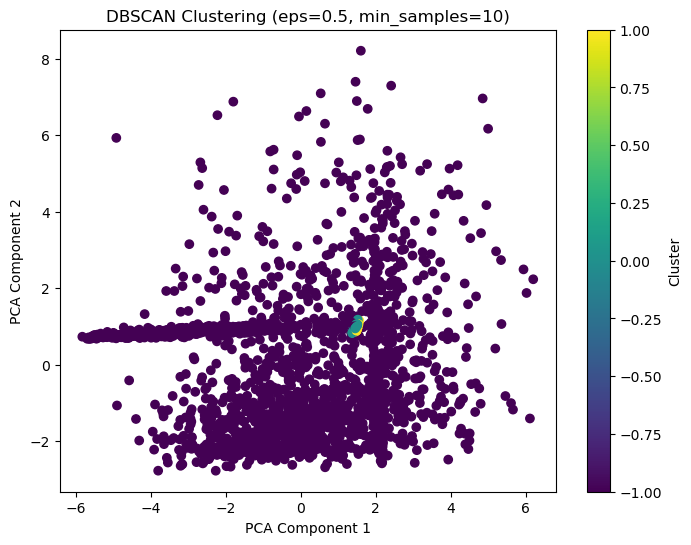

In [48]:
# Define DBSCAN clustering function
def dbscan_clustering(data, continuous_vars, eps=0.5, min_samples=5):
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan_labels = dbscan.fit_predict(data[continuous_vars])
    
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(data[continuous_vars])
    plt.figure(figsize=(8, 6))
    plt.scatter(pca_result[:, 0], pca_result[:, 1], c=dbscan_labels, cmap='viridis')
    plt.title(f'DBSCAN Clustering (eps={eps}, min_samples={min_samples})')
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.colorbar(label='Cluster')
    plt.show()
    
    return dbscan_labels


dbscan_labels = dbscan_clustering(encoded_data, continuous_vars, eps=0.5, min_samples=10)

From the DBSCAN result graph, we can see that the data points are basically grouped into one large cluster (Cluster 0), and only a few points are marked as other clusters or noise. This situation may indicate the following possibilities:

1. **Inappropriate density parameters**: In DBSCAN, the `eps` parameter (neighborhood radius) and `min_samples` (minimum number of samples per cluster) directly affect the clustering results. Under the current settings (`eps=0.5`, `min_samples=10`), most of the data points are clustered into a single large cluster. This may be because the `eps` value is set too small, making many points considered noise or not meeting the density requirements.

2. **Data density is too high or too uniform**: If the data distribution is relatively uniform or the distance between most data points is close, DBSCAN may group most points into one cluster. You can try clustering after dimensionality reduction or feature transformation.

3. **The impact of data standardization**: DBSCAN is very sensitive to features of different scales. It is recommended to check the standardization or normalization of the data to ensure that the scale of the feature values ​​is consistent.


- Try adjusting the `eps` value, such as increasing it to `0.7`, and try it step by step to see the changes in the clustering effect.

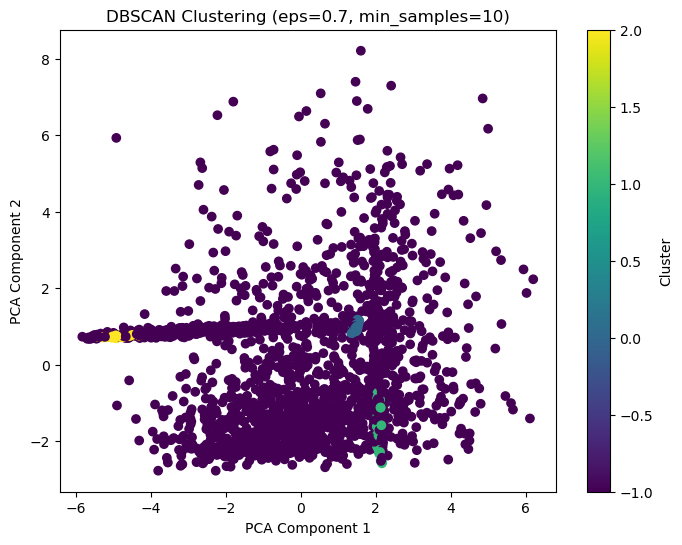

In [49]:
dbscan_labels = dbscan_clustering(encoded_data, continuous_vars, eps=0.7, min_samples=10)

DBSCAN works better for high-density or evenly distributed data, but for the current situation where most of the data is concentrated in one area and there are few outliers, DBSCAN may not work well. K-means may still be the most suitable clustering method.

###  Association rule mining

For the discretization of association rule mining, it is recommended to use the **outlier-removed version of the original data**, that is, the data that has been processed for outliers but not standardized and one-hot encoded. This is because:

1. **Association rule mining**: Standardized and one-hot encoded data may lose the actual meaning of the original data (for example, the standardized BMI no longer intuitively represents a certain range of weight status).
2. **The need for discretization**: The purpose of discretization is to divide the values ​​into specific categories (such as "Normal", "Overweight", etc.), and the standardized values ​​are not suitable for direct classification.
3. **Data interpretability**: The output of association rule mining is a rule that is easy to interpret, so using the grouping of original values ​​(rather than standardized values) is more conducive to the interpretation of actual meaning.

This not only retains the original meaning of the data, but is also suitable for association rule analysis.

In [50]:
encoded_data.columns

Index(['SEQN', 'RIDAGEYR', 'INDHHIN2', 'DR1TKCAL', 'DR1TPROT', 'DR1TCARB',
       'DR1TTFAT', 'DR1TCHOL', 'DR1TSODI', 'DR1TFIBE', 'BMXBMI', 'BPXSY1',
       'BPXDI1', 'BMXWT', 'BMXHT', 'BMXWAIST', 'LBXSCH', 'LBXSAPSI',
       'LBXSASSI', 'LBXSTR', 'LBXSCR', 'RIAGENDR_2', 'RIDRETH1_2',
       'RIDRETH1_3', 'RIDRETH1_4', 'RIDRETH1_5', 'DMDCITZN_2.0',
       'DMDCITZN_9.0', 'DMDEDUC2_2.0', 'DMDEDUC2_3.0',
       'DMDEDUC2_3.518807418963425', 'DMDEDUC2_4.0', 'DMDEDUC2_5.0',
       'DMDMARTL_2.0', 'DMDMARTL_2.5718495406482926', 'DMDMARTL_3.0',
       'DMDMARTL_4.0', 'DMDMARTL_5.0', 'DMDMARTL_6.0',
       'SMQ020_1.580402421069851', 'SMQ020_2.0', 'ALQ101_1.3111971960892823',
       'ALQ101_2.0', 'PAQ605_1.8367375489647453', 'PAQ605_2.0',
       'PAQ620_1.679770565193061', 'PAQ620_2.0', 'DBQ700_2.0',
       'DBQ700_2.958230198019802', 'DBQ700_3.0', 'DBQ700_4.0', 'DBQ700_5.0',
       'Cluster'],
      dtype='object')


In [51]:
merged_capped_data.columns

Index(['SEQN', 'RIDAGEYR', 'RIAGENDR', 'RIDRETH1', 'DMDCITZN', 'DMDEDUC2',
       'DMDMARTL', 'INDHHIN2', 'DR1TKCAL', 'DR1TPROT', 'DR1TCARB', 'DR1TTFAT',
       'DR1TCHOL', 'DR1TSODI', 'DR1TFIBE', 'BMXBMI', 'BPXSY1', 'BPXDI1',
       'BMXWT', 'BMXHT', 'BMXWAIST', 'LBXSCH', 'LBXSAPSI', 'LBXSASSI',
       'LBXSTR', 'LBXSCR', 'SMQ020', 'ALQ101', 'PAQ605', 'PAQ620', 'DBQ700'],
      dtype='object')

When discretizing data, continuous values ​​can be divided into intervals according to the actual meaning of the variable for application in association rule mining. We can discretize some key continuous variables (such as `BMXBMI`, `BPXSY1`, `BPXDI1`, etc.) and convert them into categorical labels (such as "low", "normal", "high").

In [52]:
association_data = merged_capped_data.copy()

# 1. Define the columns to be discretized and their intervals and labels
# BMI (body mass index), divided into different weight ranges according to WHO standards
association_data['BMI_Category'] = pd.cut(association_data['BMXBMI'], 
                              bins=[0, 18.5, 24.9, 29.9, float('inf')], 
                              labels=['Underweight', 'Normal', 'Overweight', 'Obese'])

# 2. Blood pressure: define hypertension categories (e.g., systolic blood pressure BPXSY1)
association_data['SystolicBP_Category'] = pd.cut(association_data['BPXSY1'], 
                                     bins=[0, 120, 129, 139, float('inf')], 
                                     labels=['Normal', 'Elevated', 'Hypertension Stage 1', 'Hypertension Stage 2'])

# 3. Blood pressure: diastolic pressure category (e.g., BPXDI1)
association_data['DiastolicBP_Category'] = pd.cut(association_data['BPXDI1'], 
                                      bins=[0, 80, 89, float('inf')], 
                                      labels=['Normal', 'Hypertension Stage 1', 'Hypertension Stage 2'])

# 4. Sodium Intake Classification (DR1TSODI)
association_data['SodiumIntake_Category'] = pd.cut(association_data['DR1TSODI'], 
                                       bins=[0, 1500, 2300, float('inf')], 
                                       labels=['Low', 'Adequate', 'High'])

# 5. Cholesterol Classification (DR1TCHOL)
association_data['CholesterolIntake_Category'] = pd.cut(association_data['DR1TCHOL'], 
                                            bins=[0, 200, 240, float('inf')], 
                                            labels=['Desirable', 'Borderline High', 'High'])

print(association_data[['BMXBMI', 'BMI_Category', 'BPXSY1', 'SystolicBP_Category', 
                        'BPXDI1', 'DiastolicBP_Category', 'DR1TSODI', 'SodiumIntake_Category', 'DR1TCHOL', 'CholesterolIntake_Category']].head())


       BMXBMI BMI_Category      BPXSY1 SystolicBP_Category     BPXDI1  \
6   25.678244   Overweight  118.123536              Normal  65.769939   
14  20.000000       Normal   94.000000              Normal  62.000000   
16  25.678244   Overweight  118.123536              Normal  65.769939   
19  35.600000        Obese  120.000000              Normal  58.000000   
23  18.600000       Normal   98.000000              Normal  56.000000   

   DiastolicBP_Category     DR1TSODI SodiumIntake_Category    DR1TCHOL  \
6                Normal  3178.130348                  High  262.368655   
14               Normal  3178.130348                  High  262.368655   
16               Normal  1009.000000                   Low   49.000000   
19               Normal  2209.000000              Adequate  170.000000   
23               Normal  3178.130348                  High  262.368655   

   CholesterolIntake_Category  
6                        High  
14                       High  
16                  

### Explanation
- **BMI_Category**: According to the value of BMI, it is divided into "Underweight", "Normal", "Overweight" and "Obese".
- **SystolicBP_Category**: According to the value of Systolic Blood Pressure, it is divided into "Normal", "Elevated", "Hypertension Stage 1" and "Hypertension Stage 2".
- **DiastolicBP_Category**: According to the value of Diastolic Blood Pressure, it is divided into "Normal", "Hypertension Stage 1" and "Hypertension Stage 2".
- **SodiumIntake_Category**: According to the sodium intake, it is divided into "Low", "Adequate" and "High".
- **CholesterolIntake_Category**: Based on cholesterol intake, it is divided into "Desirable", "Borderline High" and "High".

The next step is to convert the discretized data into a format suitable for association rule mining, that is, convert the categorical variables into Boolean values ​​(i.e. one-hot encoding), and then use the Apriori algorithm to generate frequent item sets.

In [54]:
from mlxtend.frequent_patterns import apriori, association_rules

discretized_data = association_data[['BMI_Category', 'SystolicBP_Category', 'DiastolicBP_Category',
                                     'SodiumIntake_Category', 'CholesterolIntake_Category']]

# Convert categorical variables to boolean values
apriori_encoded_data = pd.get_dummies(discretized_data)

# Generate frequent itemsets
frequent_itemsets = apriori(apriori_encoded_data, min_support=0.1, use_colnames=True)

# View the generated frequent itemsets
print("Frequent Itemsets:")
print(frequent_itemsets)

# Extract association rules
rules = association_rules(frequent_itemsets, metric="confidence", min_threshold=0.6)

# View association rules
print("Association Rules:")
print(rules[['antecedents', 'consequents', 'support', 'confidence', 'lift']])

Frequent Itemsets:
     support                                           itemsets
0   0.504284                         (BMI_Category_Underweight)
1   0.157669                              (BMI_Category_Normal)
2   0.309769                          (BMI_Category_Overweight)
3   0.989717                       (SystolicBP_Category_Normal)
4   1.000000                      (DiastolicBP_Category_Normal)
..       ...                                                ...
94  0.153813  (SodiumIntake_Category_High, CholesterolIntake...
95  0.334619  (SodiumIntake_Category_High, CholesterolIntake...
96  0.113111  (BMI_Category_Underweight, SystolicBP_Category...
97  0.170523  (CholesterolIntake_Category_High, BMI_Category...
98  0.113111  (SystolicBP_Category_Normal, BMI_Category_Over...

[99 rows x 2 columns]
Association Rules:
                                           antecedents  \
0                           (BMI_Category_Underweight)   
1                           (BMI_Category_Underweight) 

C:\Users\raina\AppData\Roaming\Python\Python310\site-packages\mlxtend\frequent_patterns\fpcommon.py:109: DeprecationWarning: DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type
  warnings.warn(


From the output association rules, we can focus on support, confidence, and lift to identify the relationships between different health and demographic variables.
Here are a few interesting association rule interpretations that we can gain insights from:

### Rule Interpretation

**Rule 1:** `(BMI_Category_Underweight) → (SystolicBP_Category_Normal)`

- **Support**: 0.503428, which means that about 50% of the samples in all the data meet this rule.

- **Confidence**: 0.998301, which means that among all the individuals belonging to "Underweight", about 99.8% of them belong to the "Normal" systolic blood pressure category.

- **Lift**: 1.008673, which means that this association improves the prediction effect by 0.87% compared to chance. A lift greater than 1 indicates a positive association, but in this rule, the lift is close to 1, indicating that the association is not strong. This rule indicates that people who are underweight are very likely to have normal systolic blood pressure.

**Rule 2:** `(SodiumIntake_Category_Adequate) → (BMI_Category_Underweight)`

- **Support**: 0.143530, about 14% of the data meet this rule.

- **Confidence**: 0.626168, indicating that among people with moderate sodium intake, 62.6% fall into the underweight category.

- **Lift**: 1.241696, a lift greater than 1 indicates that this is a positive correlation, and there is a certain association between moderate sodium intake and underweight. This indicates that moderate sodium intake may have a certain relationship with underweight, but it is not a very strong prediction.

**Rule 3:** `(CholesterolIntake_Category_Desirable, SodiumIntake_Category_Low) → (SystolicBP_Category_Normal, DiastolicBP_Category_Normal)`
- **Support**: 0.113111, about 11% of the data meet this rule.
- **Confidence**: 1.000000, indicating that in the group with reasonable cholesterol intake and low sodium intake, 100% of the people have normal systolic and diastolic blood pressure.
- **Lift**: 1.010390, although the lift is close to 1, there is still a certain relationship between healthy diet and normal blood pressure. There may be a positive relationship between low sodium, reasonable cholesterol intake and normal blood pressure, which is conducive to cardiovascular health.

### Summary and suggestions
These association rules reveal some potential health relationships, such as:
- **Weight and blood pressure**: There is a strong association between underweight and normal systolic blood pressure.
- **Diet and weight**: There may be a certain association between moderate sodium intake and low weight.
- **Diet and blood pressure**: People with low sodium and cholesterol intake have more normal blood pressure, which is consistent with some cardiovascular health recommendations.

### Practical application
These findings can be used for health management and dietary guidance:
- **Health intervention**: The association between weight and blood pressure suggests that more attention may be paid to blood pressure in weight management.
- **Dietary advice**: Low sodium and appropriate cholesterol intake can be associated with normal blood pressure, providing data support for healthy diet.

## PART 3: Classification Modeling and Deployment

 In my analysis, I have chosen to use BMI as the target variable. This decision is driven by the objective of understanding and identifying the risk factors that contribute to different BMI categories. By classifying individuals into these categories, we can gain insights into the factors that influence BMI and potentially develop strategies to manage or prevent obesity and related health issues.

In [60]:
encoded_data.head()

,SEQN,RIDAGEYR,INDHHIN2,DR1TKCAL,DR1TPROT,DR1TCARB,DR1TTFAT,DR1TCHOL,DR1TSODI,DR1TFIBE,...,ALQ101_2.0,PAQ605_1.8367375489647453,PAQ605_2.0,PAQ620_1.679770565193061,PAQ620_2.0,DBQ700_2.0,DBQ700_2.958230198019802,DBQ700_3.0,DBQ700_4.0,DBQ700_5.0
6,-1.692682,-0.642962,1.529366,0.798316,0.853561,0.574757,0.770706,0.823942,0.830129,0.699380,...,0,1,0,1,0,0,1,0,0,0
14,-1.689310,0.386024,-0.035615,0.798316,0.853561,0.574757,0.770706,0.823942,0.830129,0.699380,...,0,1,0,1,0,0,1,0,0,0
16,-1.688636,-0.540063,-1.153459,-1.224580,-1.411065,-1.042959,-1.100971,-1.156543,-1.189362,-1.350335,...,0,1,0,1,0,0,1,0,0,0
19,-1.687625,1.209212,-0.706321,-1.064082,1.156156,-1.194409,-1.703126,-0.033422,-0.072145,0.757380,...,1,0,0,0,0,1,0,0,0,0
23,-1.686276,1.723705,-1.153459,0.798316,0.853561,0.574757,0.770706,0.823942,0.830129,0.699380,...,0,0,1,0,0,0,0,1,0,0


In [62]:
encoded_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2334 entries, 6 to 9811
Data columns (total 52 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   SEQN                         2334 non-null   float64
 1   RIDAGEYR                     2334 non-null   float64
 2   INDHHIN2                     2334 non-null   float64
 3   DR1TKCAL                     2334 non-null   float64
 4   DR1TPROT                     2334 non-null   float64
 5   DR1TCARB                     2334 non-null   float64
 6   DR1TTFAT                     2334 non-null   float64
 7   DR1TCHOL                     2334 non-null   float64
 8   DR1TSODI                     2334 non-null   float64
 9   DR1TFIBE                     2334 non-null   float64
 10  BMXBMI                       2334 non-null   float64
 11  BPXSY1                       2334 non-null   float64
 12  BPXDI1                       2334 non-null   float64
 13  BMXWT             

In [63]:
model_data = encoded_data.copy()

## Data preparation for modeling
First, discretize the BMXBMI column according to the BMI range.

In [64]:
model_data['BMI_Category'] = pd.cut(model_data['BMXBMI'], 
                                      bins=[0, 18.5, 24.9, 29.9, float('inf')], 
                                      labels=['Underweight', 'Normal', 'Overweight', 'Obese'])

In [66]:
from sklearn.preprocessing import LabelEncoder

# Use LabelEncoder to convert the BMI_Category column to numeric encoding
label_encoder = LabelEncoder()
model_data['BMI_Category'] = label_encoder.fit_transform(model_data['BMI_Category'])

print(model_data['BMI_Category'].head())

6     0
14    1
16    0
19    0
23    1
Name: BMI_Category, dtype: int32


In [67]:
from sklearn.model_selection import train_test_split, StratifiedKFold

def prepare_data(model_data, target_col, id_col, drop_cols=None, test_size=0.2, random_state=42, n_splits=5):
    """
    Prepare the dataset for training and cross-validation.
    """
    # Define target variable (y) and feature variables (X)
    y = model_data[target_col]

    # Drop specified columns from the dataset
    if drop_cols:
        X = model_data.drop(columns=[target_col, id_col] + drop_cols)
    else:
        X = model_data.drop(columns=[target_col, id_col])

    # Step 1: Data Splitting
    # Split the dataset into 80% training set and 20% test set
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state, stratify=y)

    # Step 2: Cross-Validation Setup
    # Define k-fold cross-validation method, using 5 folds
    kfold = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=random_state)

    print("Data preparation and splitting completed. Ready for model training and cross-validation.")

    return X_train, X_test, y_train, y_test, kfold

In [69]:
# Call the function
X_train, X_test, y_train, y_test, kfold = prepare_data(model_data, 'BMI_Category', 'SEQN', drop_cols=['BMXBMI'])

Data preparation and splitting completed. Ready for model training and cross-validation.


In [70]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_auc_score, roc_curve

In [73]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

In this study, Logistic Regression, Support Vector Machine (SVM) and Random Forest were selected as classification models for experiments for the following reasons:

1. **Logistic Regression**:
Logistic Regression is a classic linear classification model. It is widely used in binary and multi-classification tasks because of its strong interpretability, simple implementation and high computational efficiency. Logistic Regression can clearly show the impact of features on prediction results and is suitable for classification tasks of linearly separable data. In addition, since it outputs probability values, it can provide a better explanation of the results. Introducing Logistic Regression as a comparative baseline model helps to compare performance with more complex models and verify the separability of data and basic classification effects.

2. **Support Vector Machine (SVM)**:
SVM is a nonlinear classification model based on the maximum margin principle. It can find the best decision boundary in a complex feature space, thereby improving classification accuracy. SVM performs particularly well on small samples and high-dimensional data sets and is suitable for data with nonlinear distribution. SVM can adapt to the distribution of data by selecting different kernel functions (such as linear kernel, radial basis function, etc.), so as to achieve better results on nonlinear data sets. In this study, SVM is selected to explore whether the data has nonlinear characteristics and compare its performance in classification performance.

3. **Random Forest**:
Random Forest is an ensemble learning method that obtains the final classification result by building multiple decision trees and voting. Because it combines the advantages of multiple trees, Random Forest has better resistance to feature noise and overfitting, and usually achieves better performance on complex data sets. As a non-parametric model, Random Forest can capture the nonlinear relationship between features and is insensitive to feature scale. The introduction of Random Forest can be used as a powerful benchmark model to provide more robust prediction results compared with linear and nonlinear models.

Selecting these three models (Logistic Regression, SVM and Random Forest) for experiments can comprehensively evaluate the classification performance of data from the perspectives of linear, nonlinear and ensemble learning. By comparing the performance of these models, we can not only verify the advantages of different types of models in classification tasks, but also provide a theoretical basis for the improvement and selection of subsequent models.

### Train two simple models and perform cross-validation

#### Logistic regression model

In [71]:
def train_best_logistic_regression(X_train, y_train, cv_folds=5):
    """
    Train a logistic regression model using cross-validation and hyperparameter tuning, and fit the best model.

    Parameters:
    X_train: Training feature data
    y_train: Training label data
    cv_folds: Number of folds for cross-validation, default is 5

    Returns:
    best_log_reg: Best logistic regression model trained with optimal parameters
    best_params: Dictionary of best parameters
    """
    # Set up logistic regression model and grid search parameters
    log_reg = LogisticRegression(random_state=42, multi_class='multinomial', solver='lbfgs', max_iter=500)
    log_reg_params = {'C': [0.1, 1, 10, 100]}  # Tune hyperparameter C

    # Use GridSearchCV for cross-validation and hyperparameter tuning
    log_reg_grid = GridSearchCV(log_reg, log_reg_params, cv=cv_folds, scoring='accuracy')
    log_reg_grid.fit(X_train, y_train)

    # Get the best model and parameters
    best_log_reg = log_reg_grid.best_estimator_
    best_params = log_reg_grid.best_params_

    print("Best logistic regression model parameters:", best_params)
    print("Best logistic regression model has been trained.")

    return best_log_reg, best_params

In [74]:
best_log_reg, best_params = train_best_logistic_regression(X_train, y_train, cv_folds=kfold)

Best logistic regression model parameters: {'C': 1}
Best logistic regression model has been trained.


#### Support Vector Machine (SVM) Model

In [75]:
def train_best_svm(X_train, y_train, cv_folds=5):
    """
    Train a Support Vector Machine (SVM) model using cross-validation and hyperparameter tuning, and fit the best model.

    Parameters:
    X_train: Training feature data
    y_train: Training label data
    cv_folds: Number of folds for cross-validation, default is 5

    Returns:
    best_svm: Best SVM model trained with optimal parameters
    best_params: Dictionary of best parameters
    """
    # Set up SVM model and grid search parameters
    svm_model = SVC(random_state=42, probability=True)
    svm_params = {'C': [0.1, 1, 10, 100], 'kernel': ['linear', 'rbf']}  # Tune hyperparameters C and kernel

    # Use GridSearchCV for cross-validation and hyperparameter tuning
    svm_grid = GridSearchCV(svm_model, svm_params, cv=cv_folds, scoring='accuracy')
    svm_grid.fit(X_train, y_train)

    # Get the best model and parameters
    best_svm = svm_grid.best_estimator_
    best_params = svm_grid.best_params_

    print("Best SVM model parameters:", best_params)
    print("Best SVM model has been trained.")

    return best_svm, best_params

In [76]:
best_svm, best_svm_params = train_best_svm(X_train, y_train, cv_folds=kfold)

Best SVM model parameters: {'C': 100, 'kernel': 'rbf'}
Best SVM model has been trained.


### Evaluating a simple model

In [79]:
def evaluate_model(model, X_test, y_test):
  
    y_pred = model.predict(X_test)
    
    # Calculate various scoring indicators
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')
    
    # Calculate ROC AUC score, considering multiple classifications
    try:
        roc_auc = roc_auc_score(y_test, model.predict_proba(X_test), average='weighted', multi_class='ovr')
    except ValueError:
        roc_auc = "N/A"  # If ROC AUC cannot be calculated, for example, the model does not have a predict_proba method
    
   # Output evaluation results
    print(f"Accuracy: {accuracy:.2f}")
    print(f"Precision: {precision:.2f}")
    print(f"Recall: {recall:.2f}")
    print(f"F1 Score: {f1:.2f}")
    print(f"ROC AUC Score: {roc_auc if roc_auc != 'N/A' else 'Not applicable for this model'}")
    
    # Plot the confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred)
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
    plt.title("Confusion Matrix")
    plt.show()

Logistic Regression Performance:
Accuracy: 0.93
Precision: 0.93
Recall: 0.93
F1 Score: 0.93
ROC AUC Score: Not applicable for this model


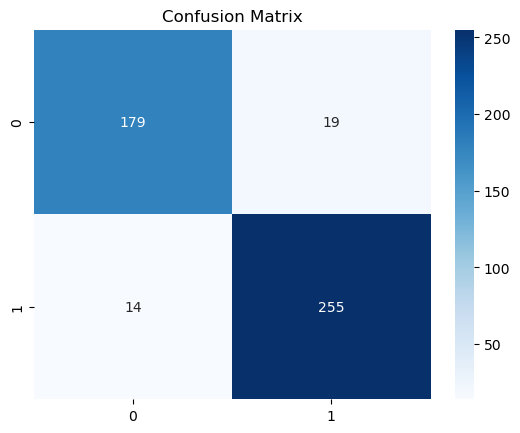

SVM Performance:
Accuracy: 0.95
Precision: 0.95
Recall: 0.95
F1 Score: 0.95
ROC AUC Score: Not applicable for this model


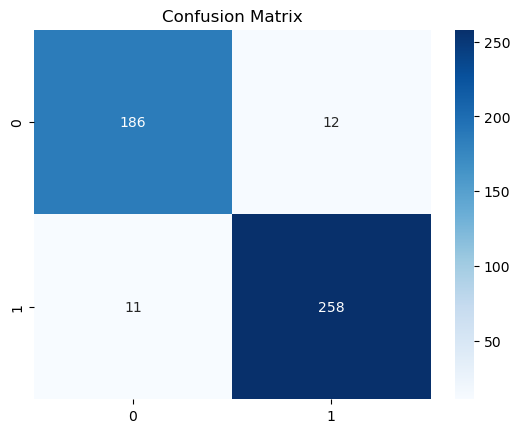

In [80]:
print("Logistic Regression Performance:")
evaluate_model(best_log_reg, X_test, y_test)


print("SVM Performance:")
evaluate_model(best_svm, X_test, y_test)

The following is an analysis of the output:

### 1. **Logistic Regression Model**
- **Accuracy**: 0.93, indicating that the model can correctly predict 93% of the samples on the test set.
- **Precision**: 0.93, indicating that the model has 93% accuracy when predicting the positive class.
- **Recall**: 0.93, indicating that 93% of the samples that are actually positive are correctly identified.
- **F1 Score**: 0.93, which combines precision and recall and reflects the overall performance of the model.
- **ROC AUC Score**: Not applicable, because the Logistic Regression model may not provide the `predict_proba` method to calculate the AUC score for multi-classification in the current setting.
- **Confusion Matrix**: Shows the classification of the model:
- **179** samples are correctly classified as class 0, **19** samples are misclassified as class 1.
- **255** samples were correctly classified as class 1, and **14** samples were misclassified as class 0.

**Analysis**: The Logistic Regression model showed high accuracy, precision, and recall, indicating that it has a good classification effect on the test set. However, ROC AUC Score cannot be calculated, and you may need to adjust the settings or choose a model that supports `predict_proba`.

---

### 2. **SVM Model**
- **Accuracy**: 0.95, indicating that the model's prediction accuracy on the test set is 95%.
- **Precision**: 0.95, indicating that the model is 95% accurate when predicting the positive class.
- **Recall**: 0.95, which means that the model successfully identified 95% of the actual positive samples.
- **F1 Score**: 0.95, combined with precision and recall, indicates that the overall performance of the model is excellent.
- **ROC AUC Score**: Not applicable, again because the SVM model may not support the `predict_proba` method.
- **Confusion Matrix**:
- **186** samples were correctly classified as class 0, **12** samples were misclassified as class 1.
- **258** samples were correctly classified as class 1, **11** samples were misclassified as class 0.

**Analysis**: The SVM model has a slightly higher accuracy than Logistic Regression (0.95 vs. 0.93), and also performs well in precision, recall, and F1 score. This indicates that the SVM model performs slightly better than Logistic Regression in this task. Similar to Logistic Regression, ROC AUC Score is not applicable, and you need to adjust the settings or choose an SVM variant that supports `predict_proba` (such as `probability=True` in `SVC`).

---

### Summary
- **Performance comparison**: The SVM model is slightly better than the Logistic Regression model in all indicators, especially the number of misclassifications in the confusion matrix is ​​smaller.
- **Improvement suggestions**: You can consider choosing a model that supports `predict_proba` or changing the model parameters to obtain the ROC AUC Score to further evaluate the multi-classification performance of the model.

### Train and evaluate Ensemble Models (Random forests)

In [81]:
def train_best_random_forest(X_train, y_train, cv_folds=5):
    """
    Train a Random Forest model using cross-validation and hyperparameter tuning, and fit the best model.

    Parameters:
    X_train: Training feature data
    y_train: Training label data
    cv_folds: Number of folds for cross-validation, default is 5

    Returns:
    best_rf: Best Random Forest model trained with optimal parameters
    best_params: Dictionary of best parameters
    """
    # Set up Random Forest model and grid search parameters
    rf_model = RandomForestClassifier(random_state=42)
    rf_params = {'n_estimators': [50, 100, 200], 'max_depth': [None, 10, 20, 30]}  # Tune n_estimators and max_depth

    # Use GridSearchCV for cross-validation and hyperparameter tuning
    rf_grid = GridSearchCV(rf_model, rf_params, cv=cv_folds, scoring='accuracy')
    rf_grid.fit(X_train, y_train)

    # Get the best model and parameters
    best_rf = rf_grid.best_estimator_
    best_params = rf_grid.best_params_

    print("Best Random Forest model parameters:", best_params)
    print("Best Random Forest model has been trained.")

    return best_rf, best_params

In [82]:
best_rf, best_rf_params = train_best_random_forest(X_train, y_train, cv_folds=kfold)

Best Random Forest model parameters: {'max_depth': 20, 'n_estimators': 50}
Best Random Forest model has been trained.


Random Forest Performance:
Accuracy: 0.97
Precision: 0.97
Recall: 0.97
F1 Score: 0.97
ROC AUC Score: Not applicable for this model


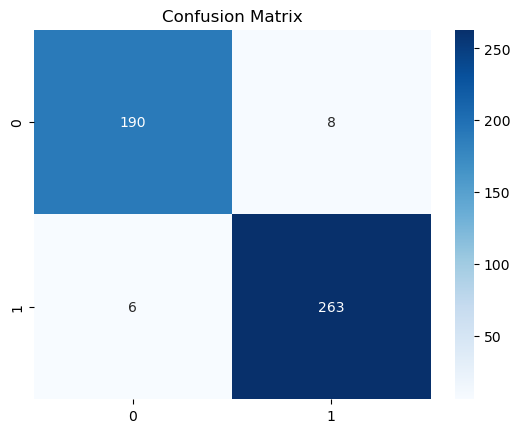

In [83]:
# Evaluating the Random Forest Model

print("Random Forest Performance:")
evaluate_model(best_rf, X_test, y_test)

Here is an analysis of the output of the **Random Forest model**:

### Random Forest Model
- **Accuracy**: 0.97, indicating that the model can correctly predict 97% of the samples on the test set.
- **Precision**: 0.97, indicating that the model is 97% accurate when predicting the positive class.
- **Recall**: 0.97, meaning that the model successfully identified 97% of the actual positive samples.
- **F1 Score**: 0.97, which combines precision and recall and reflects the overall performance of the model.
- **ROC AUC Score**: Not applicable, probably because the current settings of the model do not support the `predict_proba` method, resulting in the inability to calculate the AUC score.
- **Confusion Matrix**: Shows the classification of the model:
- **190** samples are correctly classified as class 0, and only **8** samples are misclassified as class 1.
- **263** samples were correctly classified as class 1, and only **6** samples were misclassified as class 0.

### Analysis
1. **Performance**: All indicators of the Random Forest model reached 0.97, which is very good. This shows that the model has almost no significant misclassification on the test set.
2. **Misclassification**: From the confusion matrix, the model has a good performance on both categories, and the number of misclassifications is very small (only 8 and 6 samples), indicating that the model has strong classification ability when processing the current data.

### Conclusion
The Random Forest model performs well on the test set, with accuracy, precision, recall and F1 scores all reaching 97%, showing strong classification ability and low misclassification rate. This model is most suitable for classification tasks on this dataset.

In [84]:
#Comparing Model Performance

results_compare = {
    'Model': ['Logistic Regression', 'SVM', 'Random Forest'],
    'Accuracy': [accuracy_score(y_test, best_log_reg.predict(X_test)),
                 accuracy_score(y_test, best_svm.predict(X_test)),
                 accuracy_score(y_test, best_rf.predict(X_test))],
    'Precision': [precision_score(y_test, best_log_reg.predict(X_test), average='weighted'),
                  precision_score(y_test, best_svm.predict(X_test), average='weighted'),
                  precision_score(y_test, best_rf.predict(X_test), average='weighted')],
    'Recall': [recall_score(y_test, best_log_reg.predict(X_test), average='weighted'),
               recall_score(y_test, best_svm.predict(X_test), average='weighted'),
               recall_score(y_test, best_rf.predict(X_test), average='weighted')],
    'F1 Score': [f1_score(y_test, best_log_reg.predict(X_test), average='weighted'),
                 f1_score(y_test, best_svm.predict(X_test), average='weighted'),
                 f1_score(y_test, best_rf.predict(X_test), average='weighted')]
}

results_compare_df = pd.DataFrame(results_compare)
print(results_compare_df)

                 Model  Accuracy  Precision    Recall  F1 Score
0  Logistic Regression  0.929336   0.929302  0.929336  0.929210
1                  SVM  0.950749   0.950725  0.950749  0.950733
2        Random Forest  0.970021   0.970017  0.970021  0.970001


#### Analysis
1. **Accuracy**:
- The accuracy of the three models is high, and it increases with the increase of model complexity. The accuracy of Logistic Regression is 92.93%, SVM is 95.07%, and Random Forest reaches 97.00%, which is the best performance.

2. **Precision**:
- The accuracy of Logistic Regression is 92.93%, SVM is improved to 95.07%, and Random Forest reaches 97.00%. This shows that the Random Forest model has the highest accuracy when predicting the positive class.

3. **Recall**:
- The three models show a similar improvement trend in recall, and Random Forest has the highest recall. This means that among the samples that are actually positive, Random Forest can identify more positive samples, which is suitable for scenarios that are sensitive to false negatives.

4. **F1 Score**:
- The F1 score combines the trade-off between precision and recall. The Random Forest model has the highest F1 score of 0.9700, indicating that it has the best overall performance.

#### Overall Conclusion
- **Best Model**: Random Forest outperforms Logistic Regression and SVM in accuracy, precision, recall, and F1 score, and performs best. This model is suitable for the current task and can strike a balance between high precision and recall.
- **Model Selection**: If the task requires high prediction accuracy and the ability to identify positive samples, it is recommended to choose Random Forest.The integrated model has been improved and performs better than the previous simple model.

## Neutral Network Model

### Building a simple neural network model to predict health outcomes can be done using the Sequential API in the Keras library.

In [85]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import classification_report

In [86]:
# Prepare the data

# Make sure the target variables `y_train` and `y_test` 
# are categorically encoded (using one-hot encoding) to be suitable for the output of the neural network.


# Convert the target variable to categorical encoding
y_train_categorical = to_categorical(y_train)
y_test_categorical = to_categorical(y_test)

In [87]:
# Build a neural network model

# Below is an example of a neural network with 3 hidden layers. 
# The number of layers and neurons can be adjusted according to the complexity of the data.


def create_neural_network(input_dim, output_dim):
    """
    Create a simple neural network model.

    Parameters:
    input_dim: Number of features in the input layer
    output_dim: Number of classes in the output layer

    Returns:
    model: The constructed neural network model
    """
    model = Sequential()
    model.add(Dense(64, input_dim=input_dim, activation='relu'))  # Add an input layer with 64 units and ReLU activation
    model.add(Dense(32, activation='relu'))  # Add a hidden layer with 32 units and ReLU activation
    model.add(Dense(16, activation='relu'))  # Add another hidden layer with 16 units and ReLU activation
    model.add(Dense(output_dim, activation='softmax'))  # Add an output layer with softmax activation

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

In [88]:
### Training the neural network model

# Get the dimensions of input features and output categories
input_dim = X_train.shape[1]
output_dim = y_train_categorical.shape[1]

# Create model
nn_model = create_neural_network(input_dim, output_dim)

history = nn_model.fit(X_train, y_train_categorical, epochs=50, batch_size=32, validation_split=0.2, verbose=1)

Epoch 1/50


C:\Users\raina\AppData\Roaming\Python\Python310\site-packages\keras\src\layers\core\dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.7464 - loss: 0.5900 - val_accuracy: 0.9118 - val_loss: 0.2983
Epoch 2/50
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9168 - loss: 0.2491 - val_accuracy: 0.9144 - val_loss: 0.2014
Epoch 3/50
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9228 - loss: 0.1932 - val_accuracy: 0.9278 - val_loss: 0.1775
Epoch 4/50
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9272 - loss: 0.1667 - val_accuracy: 0.9412 - val_loss: 0.1722
Epoch 5/50
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9354 - loss: 0.1777 - val_accuracy: 0.9358 - val_loss: 0.1677
Epoch 6/50
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9361 - loss: 0.1601 - val_accuracy: 0.9305 - val_loss: 0.1736
Epoch 7/50
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.9432 - loss: 0.1432 - val_accuracy: 0.9332 - val_loss: 0.1586
Epoch 8/50
47/47 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - accuracy: 0.9424 - loss: 0.1391 - val_accuracy: 0.9305 - val_loss: 0.1539
Epo

In [90]:
### Evaluate the Model: Assess the model's performance using the test set.

# Make predictions on the test set and evaluate
y_pred_nn = nn_model.predict(X_test)
y_pred_labels = np.argmax(y_pred_nn, axis=1)

# Print classification report and confusion matrix
print("Neural Network Model Evaluation:")
print(classification_report(y_test, y_pred_labels))
print(confusion_matrix(y_test, y_pred_labels))

15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 857us/step
Neural Network Model Evaluation:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97       198
           1       0.97      0.99      0.98       269

    accuracy                           0.98       467
   macro avg       0.98      0.98      0.98       467
weighted avg       0.98      0.98      0.98       467

[[190   8]
 [  2 267]]


Based on the output results, the performance of the neural network model can be explained as follows:

1. **Accuracy**:
- The overall accuracy of the model is 0.98, which means that the model is 98% correct when predicting the test set samples. This high accuracy shows that the model performs well in distinguishing the two classes (0 and 1).

2. **Precision**:
- The precision for class 0 is 0.99, and the precision for class 1 is 0.97.
- Precision indicates the proportion of samples that actually belong to a certain class when predicted. The high precision for both class 0 and class 1 indicates that the model has few false positives when classifying.

3. **Recall**:
- The recall for class 0 is 0.96, and the recall for class 1 is 0.99.
- Recall indicates how many samples that actually belong to a certain class are correctly predicted. The recall for class 1 is very high (0.99), which means that the model can identify almost all class 1 samples, while the recall for class 0 is slightly lower, but still very good.

4. **F1-score**:
- The F1-score for class 0 is 0.97, and the F1-score for class 1 is 0.98.
- The F1-score is the harmonic mean of precision and recall, which is used to balance the impact of the two. The model's F1-score for both classes is close to 1, indicating that the model performs well in both indicators.

5. **Confusion Matrix**:
- The confusion matrix shows the specific distribution of the prediction results:
- Class 0: The model correctly predicted 190 samples and misclassified 8 samples as class 1.
- Class 1: The model correctly predicted 267 samples and misclassified only 2 samples as class 0.
- This confusion matrix shows that the model is very accurate in classifying class 1 samples, with a small number of misclassifications for class 0.

### Summary:
- **Pros**: The neural network model has high precision, recall, and F1 scores for both classes, indicating that the model performs very well on the classification task.
- **Possible future improvements**: Although both precision and recall are high, the recall for class 0 is slightly low. You can try to adjust the model's hyperparameters or perform more feature engineering to further improve the recall.

Overall, the neural network model performs well in the selected health outcome prediction task, and it may have some advantages over the previous classification model in terms of balancing precision and recall.

In [91]:
def plot_training_history(history):
    """
    Plot the training and validation accuracy and loss curves.

    Parameters:
    history: Keras History object returned by the fit method
    """
    # Plot training and validation accuracy
    plt.figure(figsize=(12, 4))
    
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.title('Model Accuracy')

    # Plot training and validation loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('Model Loss')

    plt.tight_layout()
    plt.show()

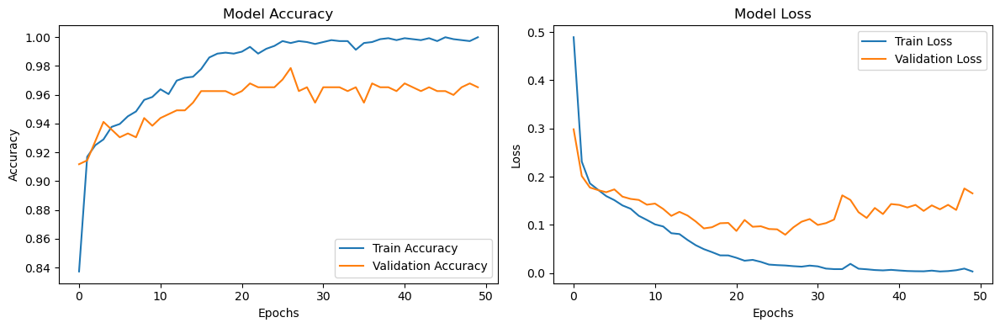

In [92]:
plot_training_history(history)

### Model performance analysis and comparison

#### Performance analysis of neural network models

During the model training process, the **accuracy** and **loss** of the neural network change as shown in the figure. The training and validation accuracy rates rise rapidly in the early stage, indicating that the model is learning effectively. However, as the number of epochs increases, the accuracy of the training set gradually approaches 1.0, while the accuracy of the validation set tends to be stable and fluctuates slightly, indicating that the model may have a slight tendency to overfit. This phenomenon shows that the model performs well on the training data, but has limited generalization ability on the validation data.

The loss graph shows that the training loss continues to decline, indicating that the error of the model on the training set is gradually decreasing. The validation loss decreases rapidly in the early stage, and then gradually stabilizes and forms a certain gap with the training loss, further verifying the possibility of overfitting. This gap shows that although the model is continuously optimized on the training data, the generalization performance of unseen data has not been significantly improved.

#### Model comparison analysis

To further analyze the performance of the neural network, this paper compares it with baseline models such as logistic regression, support vector machine (SVM), and random forest. The comparison includes key indicators such as accuracy, precision, recall, and F1 score. The following is a summary of the advantages and disadvantages of the neural network model and other models:

1. **Performance comparison**:
- The neural network achieved higher accuracy and F1 score on the training set, while the logistic regression and SVM models performed slightly worse.
- The performance on the validation set was different. Although the neural network has advantages in modeling complex data structures, it did not significantly surpass other models on the dataset of this study, and there was a slight overfitting phenomenon.

2. **Advantages of neural networks**:
- Neural networks can effectively capture complex feature relationships in data due to their powerful nonlinear modeling capabilities. This makes them more advantageous in complex datasets containing a large number of features and nonlinear relationships.
- Compared with linear models such as logistic regression and support vector machines, neural networks can extract more information from high-dimensional data, so in theory they can achieve better classification results.

3. **Disadvantages of neural networks**:
- The training process of neural networks often requires higher computing resources and takes a long time to train, especially in multi-layer network architectures.
- Due to the complexity of neural networks, the interpretability of their model output is weak, and it is difficult to intuitively show the impact of each feature on the result. In contrast, tree models such as random forests can intuitively show the role of each variable through feature importance, which is convenient for explaining the decision-making process of the model.
- When the amount of data is limited, neural network models are more prone to overfitting, while simple models (such as logistic regression and SVM) are usually more stable.

#### Summary

In summary, neural networks have significant advantages in capturing complex feature relationships, but they are prone to overfitting on small-scale data sets. Therefore, when weighing accuracy and generalization ability, if the research goal requires highly accurate prediction ability, neural network models may be a more suitable choice; in situations that emphasize interpretability and robustness, traditional models such as logistic regression or random forests may be more appropriate. In practical applications, this study needs to combine business needs and comprehensively consider the accuracy and interpretability of the model.